<center><h1>DeepGlobe Road Extraction - Modeling</h1></center>

## 1. `import` Packages

In [ ]:
! pip install imgaug --quiet
! pip install -U segmentation-models==0.2.1 --quiet
! pip install tensorflow==2.2.0 --quiet
! pip install keras==2.3.1 --quiet
! pip install patool --quiet

In [ ]:
import warnings
warnings.filterwarnings('ignore')

import os
import patoolib
import os
import pandas as pd
import cv2 as cv
import numpy as np

from tqdm import tqdm
from matplotlib import pyplot as plt
from sklearn.model_selection import train_test_split

import tensorflow as tf
import imgaug.augmenters as iaa
import segmentation_models as sm

from tensorflow.keras.models import Model
from segmentation_models import Unet
from segmentation_models.metrics import iou_score

# sm.set_framework('tf.keras')
tf.keras.backend.set_image_data_format('channels_last')

os.environ['TF_FORCE_GPU_ALLOW_GROWTH'] = 'true'

Using TensorFlow backend.


## 2. Load Data

In [ ]:
project_path = '/content/drive/MyDrive/AAIC/SCS-2/deep_globe_road_extraction/'

In [ ]:
# ! gdown --id 1--tT1cPD-vbbPXFKrbFvxjsDEzV81B1T

In [ ]:
# patoolib.extract_archive(archive='/content/DeepGlobe_256.zip', outdir='/content/DeepGlobe')

In [ ]:
file_path = '/content/DeepGlobe/metadata.csv'
df = pd.read_csv(filepath_or_buffer=file_path)

Filter data based on `split` value.

In [ ]:
train_data = df[df['split'] == 'train']
valid_data = df[df['split'] == 'valid']
test_data = df[df['split'] == 'test']

## 3. Data Generator (No Augmentation)

In [ ]:
class Dataset:
    def __init__(self, df):
        self.df = df

        self.w = 256
        self.h = 256
        
        # paths of images
        self.sat_images  = self.df['sat_image_path'].to_list()
    
        # paths of masked images
        self.masks_fps    = self.df['mask_path'].to_list()
    
        # labels for each class
        self.class_values = [0, 255]
    
    def __getitem__(self, i):
        
        # read data
        image = cv.imread('/content/DeepGlobe/' + self.sat_images[i], cv.IMREAD_UNCHANGED)
        image = cv.cvtColor(image, cv.COLOR_BGR2RGB)

        image_mask  = cv.imread('/content/DeepGlobe/' + self.masks_fps[i], cv.IMREAD_UNCHANGED)
        image_mask = image_mask[:,:,0]
        image_masks = [(image_mask == v) for v in self.class_values]
        image_mask = np.stack(image_masks, axis=-1).astype('float')
            
        return image, image_mask
    
    def __len__(self):
        return len(self.df)

In [ ]:
class DataLoder(tf.keras.utils.Sequence):    
    def __init__(self, dataset, batch_size=1, shuffle=False):
        self.dataset = dataset
        self.batch_size = batch_size
        self.shuffle = shuffle
        self.indexes = np.arange(len(dataset))

    def __getitem__(self, i):
        # collect batch data
        start = i * self.batch_size
        stop = (i + 1) * self.batch_size
        
        data = []
        for j in range(start, stop):
            data.append(self.dataset[j])
        
        batch = [np.stack(samples, axis=0) for samples in zip(*data)]
        
        return tuple(batch)
    
    def __len__(self):
        return len(self.indexes) // self.batch_size
    
    def on_epoch_end(self):
        if self.shuffle:
            self.indexes = np.random.permutation(self.indexes)

## 4. Segmentation Models

No data augmentation

In [ ]:
class ModelDesign:
    def __init__(self, train_data, model_name):
        self.width = 256
        self.height = 256
        
        self.train_data = train_data

        # base model from segmentation models
        self.model_name = model_name
    
    def _get_model(self):
        model = Unet(
            backbone_name=self.model_name, 
            encoder_weights='imagenet', 
            classes=2, 
            activation='softmax', 
            input_shape=(self.width, self.height, 3), 
            encoder_freeze=True
        )
        return model
    
    def _plot_xy(self, x, y1, y2, yl, xl='epochs'):
        plt.plot(x, y1, label='train')
        plt.plot(x, y2, label='validation')
        plt.xlabel(xl)
        plt.ylabel(yl)
        plt.title('Train VS Validation')
        plt.legend()
        plt.show()
        return None
    
    def _plot_performance(self, tracker, epochs):
        x = list(range(1, epochs + 1))

        train_iou = tracker.history['iou_score']
        valid_iou = tracker.history['val_iou_score']

        train_loss = tracker.history['loss']
        valid_loss = tracker.history['val_loss']

        self._plot_xy(x=x, y1=train_iou, y2=valid_iou, yl='iou_score')
        self._plot_xy(x=x, y1=train_loss, y2=valid_loss, yl='loss')

        return None
    
    def train_model(self, batch_size=1, epochs=20, show_performance=True):
        from keras.callbacks import ModelCheckpoint, EarlyStopping

        model = self._get_model()

        # since the original validation data does not have masks
        # i am considering `1%` of `train_data` as the `custom_validation`
        # in order to keep track of the model's performance
        self.custom_train, self.custom_valid = train_test_split(self.train_data, test_size=0.1, random_state=42)

        train_dataset = Dataset(df=self.custom_train)
        valid_dataset = Dataset(df=self.custom_valid)

        train_dataloader = DataLoder(train_dataset, batch_size=batch_size, shuffle=True)
        valid_dataloader = DataLoder(valid_dataset, batch_size=batch_size, shuffle=True)

        optimizer = tf.keras.optimizers.Adam(0.001)

        # cce_dice_loss = categorical_crossentropy + dice_loss
        focal_loss = sm.losses.cce_dice_loss

        # callbacks
        model_path = project_path + 'models/{}.h5'.format(self.model_name)
        model_save_callback = ModelCheckpoint(
            filepath=model_path,
            save_weights_only=True,
            save_best_only=True,
            mode='max',
            monitor='val_iou_score'
        )
        early_stop_callback = EarlyStopping(monitor='val_iou_score', min_delta=0.01, patience=3, verbose=1)
        callbacks = [model_save_callback, early_stop_callback]

        model.compile(optimizer=optimizer, loss=focal_loss, metrics=[iou_score])

        if not os.path.isfile(path=model_path):
            tracker = model.fit(
                x=train_dataloader,
                steps_per_epoch=len(train_dataloader),
                epochs=epochs,
                validation_data=valid_dataloader,
                callbacks=callbacks
            )
            model.load_weights(model_path)

            if show_performance:
                self._plot_performance(tracker=tracker, epochs=len(tracker.history['iou_score']))
        
        else:
            print('Model is already trained and is present in directory.')
            model.load_weights(model_path)
        
        return model
    
    def plot_custom_valid_performance(self, model, n=10):
        vdata = self.custom_valid.head(n)
        h = self.height
        w = self.width

        # paths of images
        images_fps   = vdata['sat_image_path'].to_list()
        # paths of masked images
        masks_fps    = vdata['mask_path'].to_list()

        for oimg, mimg in zip(images_fps, masks_fps):
            # original image
            simage = cv.imread('/content/DeepGlobe/' + oimg, cv.IMREAD_UNCHANGED)
            simage = cv.cvtColor(simage, cv.COLOR_BGR2RGB)

            # mask image
            mimage = cv.imread('/content/DeepGlobe/' + mimg, cv.IMREAD_UNCHANGED)

            # prediction
            predicted_image  = model.predict(simage[np.newaxis,:,:,:])
            predicted_mask = tf.argmax(predicted_image, axis=-1)
            
            # titles
            image_title = oimg.split('/')[-1]
            mask_title = mimg.split('/')[-1]
            
            # plotting figure
            plt.figure(figsize=(15, 6))
            
            plt.subplot(131)
            plt.axis("off")
            plt.title(image_title)
            plt.imshow(simage)

            plt.subplot(132)
            plt.axis("off")
            plt.title(mask_title)
            plt.imshow(mimage)

            plt.subplot(133)
            plt.axis("off")
            plt.title("Prediction - {}".format(image_title))
            plt.imshow(predicted_mask[0], cmap='gray')
            
            plt.show()
        
        return None
    
    def extract_road_path(self, x, model, n=10):
        x_ = x.head(n)
        h = self.height
        w = self.width

        # paths of images
        images_fps   = x_['sat_image_path'].to_list()
        # paths of masked images
        masks_fps    = x_['mask_path'].to_list()

        for oimg, mimg in zip(images_fps, masks_fps):
            # original image
            image = cv.imread('/content/DeepGlobe/' + oimg, cv.IMREAD_UNCHANGED)
            image = cv.cvtColor(image, cv.COLOR_BGR2RGB)

            # prediction
            predicted_image  = model.predict(image[np.newaxis,:,:,:])
            predicted_mask = tf.argmax(predicted_image, axis=-1)
            image_title = oimg.split('/')[-1]
            
            plt.figure(figsize=(10, 6))
            
            plt.subplot(121)
            plt.axis("off")
            plt.title(image_title)
            plt.imshow(image)

            plt.subplot(122)
            plt.axis("off")
            plt.title("Prediction - {}".format(image_title))
            plt.imshow(predicted_mask[0], cmap='gray')
            
            plt.show()
        
        return None

### 4.1. ResNet34

#### 4.1.1. Object creation

In [ ]:
m = ModelDesign(
    train_data=train_data,
    model_name='resnet34'
)


#### 4.1.2. Model training

In [ ]:
model = m.train_model()

Model is already trained and is present in directory.


<center><img src="https://user-images.githubusercontent.com/63333753/153398528-1d2c8edb-544f-4105-8cbf-e9acf774831e.png"></center>

#### 4.1.3. Valid prediction

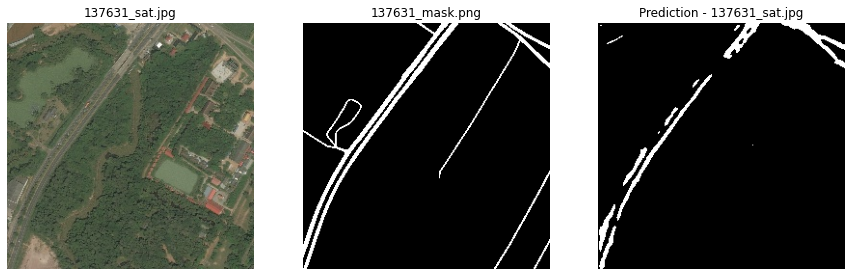

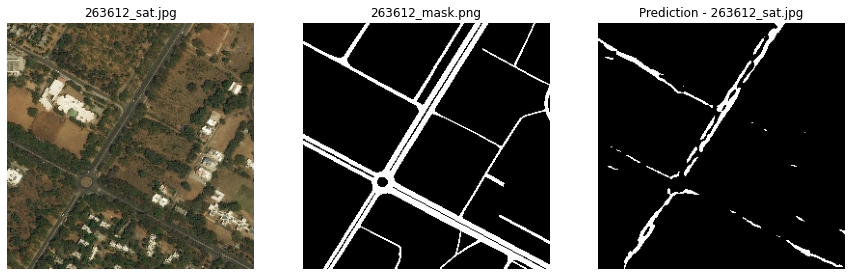

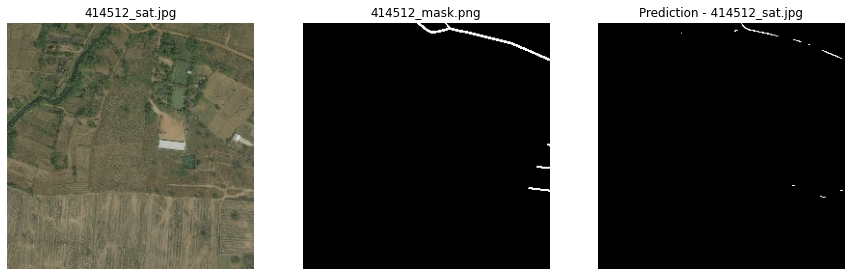

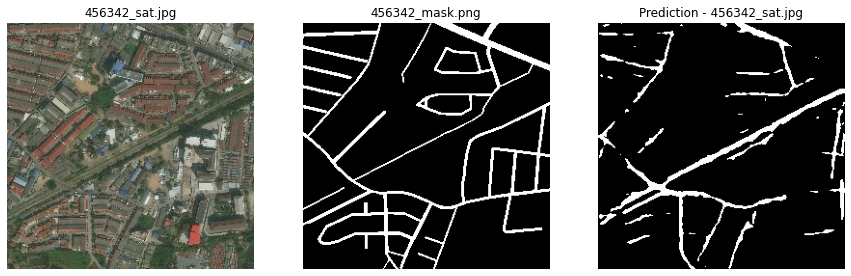

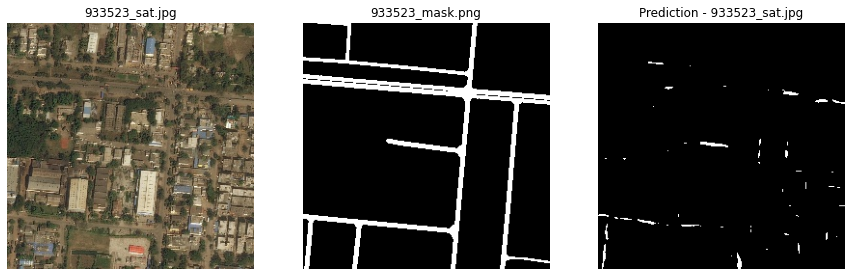

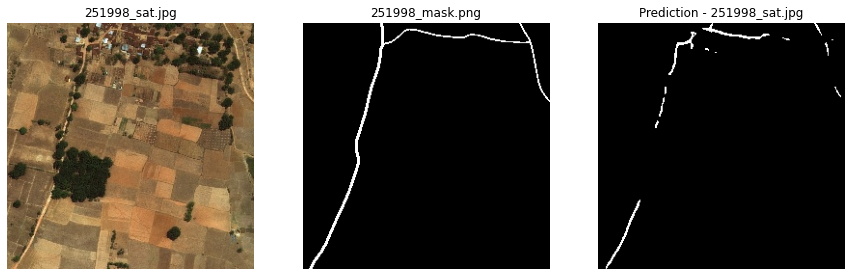

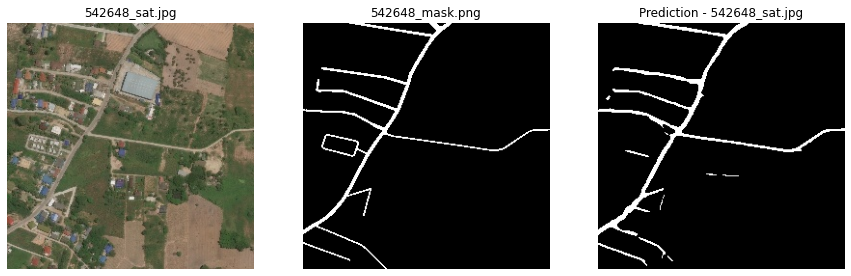

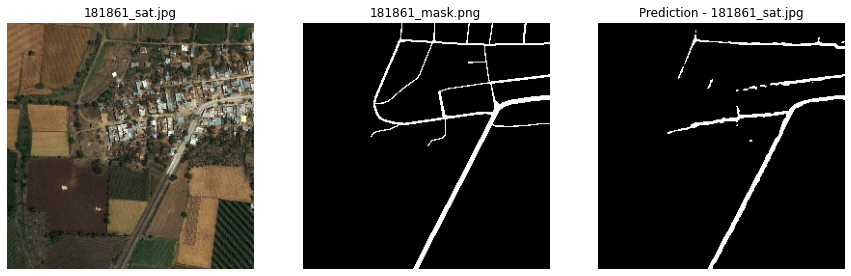

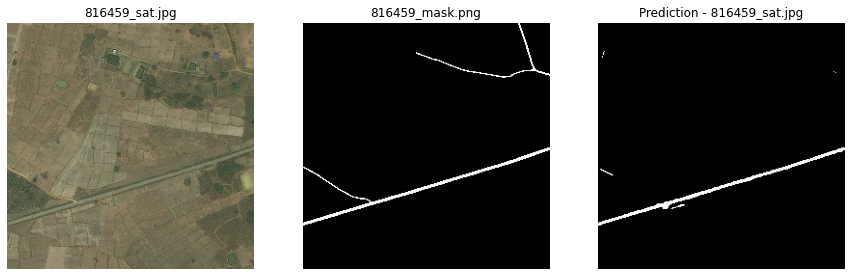

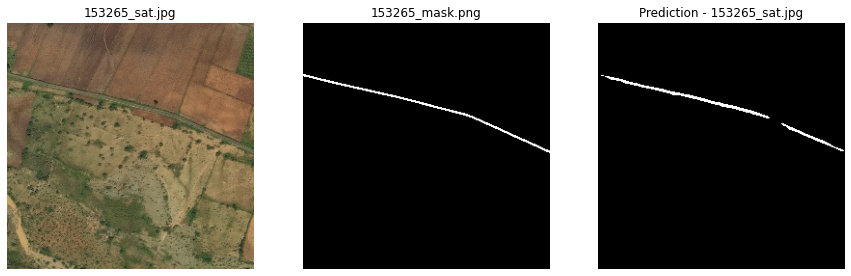

In [ ]:
m.plot_custom_valid_performance(model=model)

#### 4.1.4. Test prediction

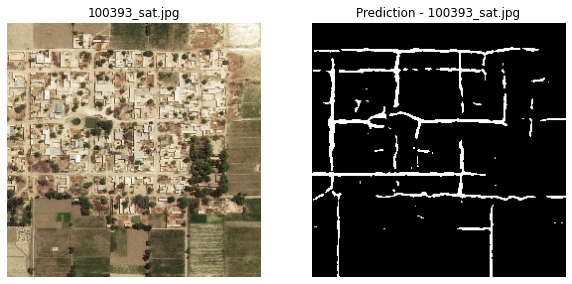

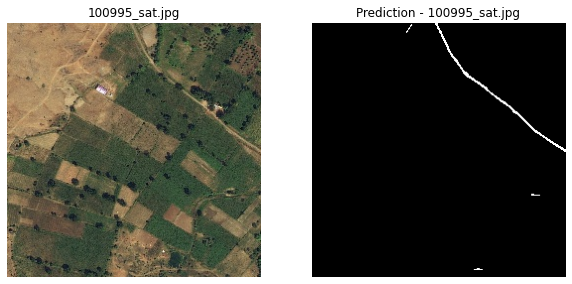

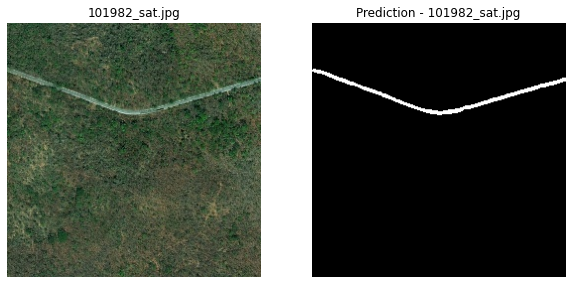

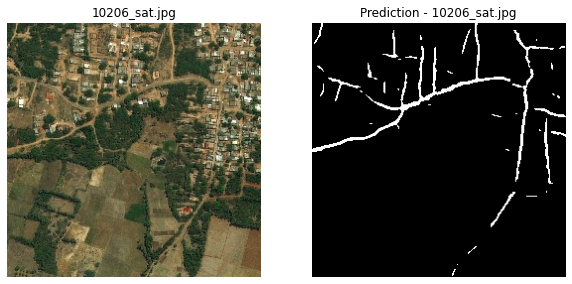

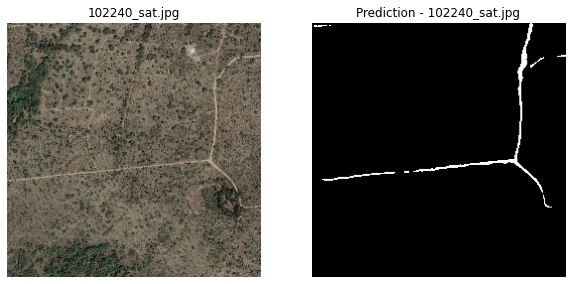

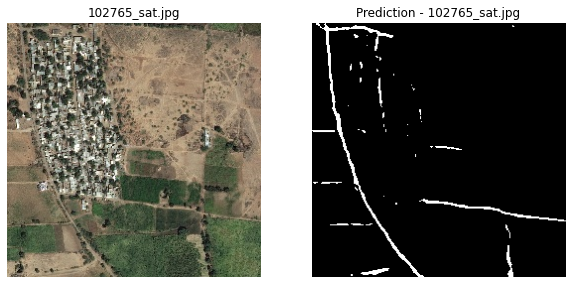

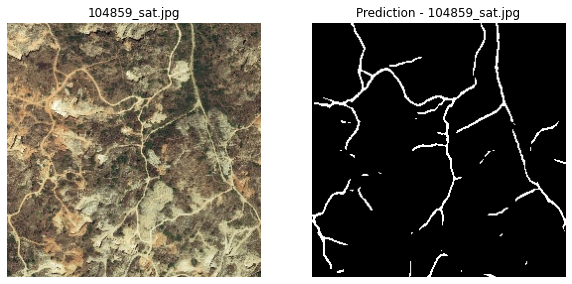

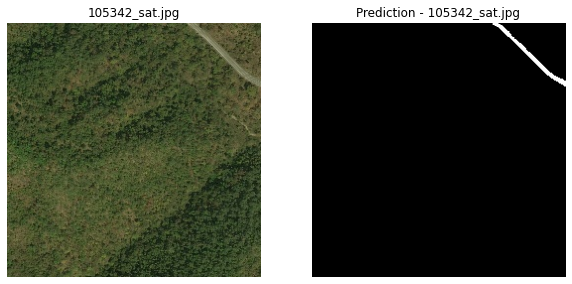

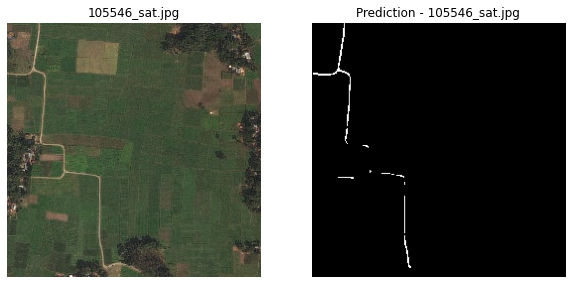

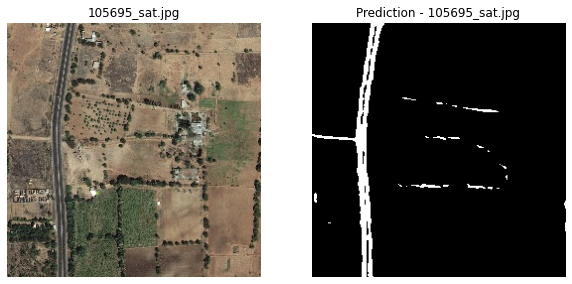

In [ ]:
m.extract_road_path(x=test_data, model=model)

### 4.2. VGG16

#### 4.2.1. Object creation

In [ ]:
m = ModelDesign(
    train_data=train_data,
    model_name='vgg16'
)

#### 4.2.2. Model training

In [ ]:
model = m.train_model()

Model is already trained and is present in directory.


<center><img src="https://user-images.githubusercontent.com/63333753/153401703-d34af7c7-d2ad-4057-9f70-7e8b2784dfa6.png"></center>

#### 4.2.3. Valid prediction

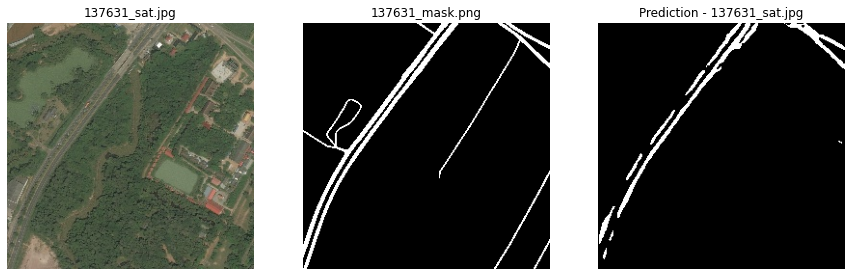

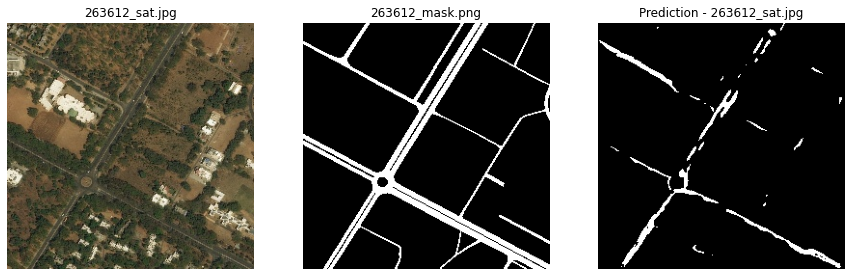

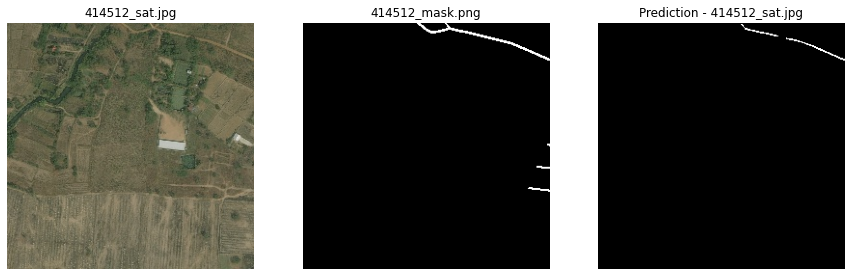

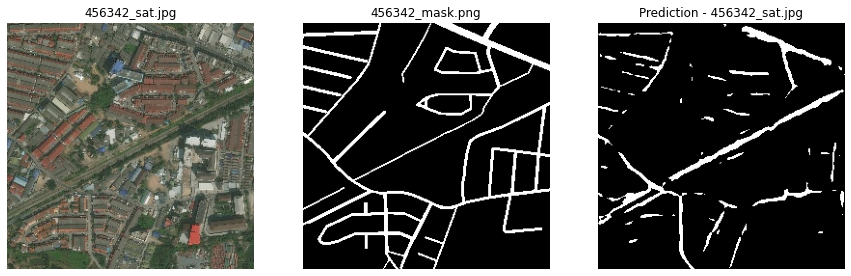

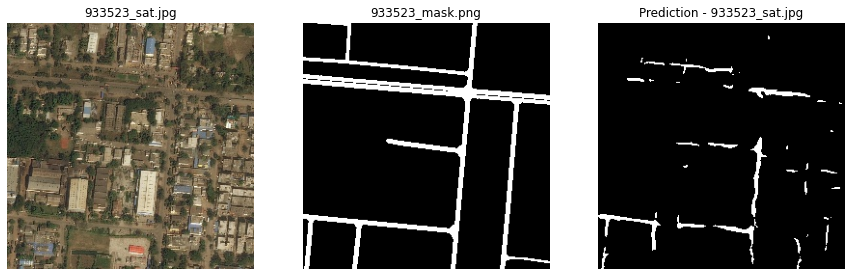

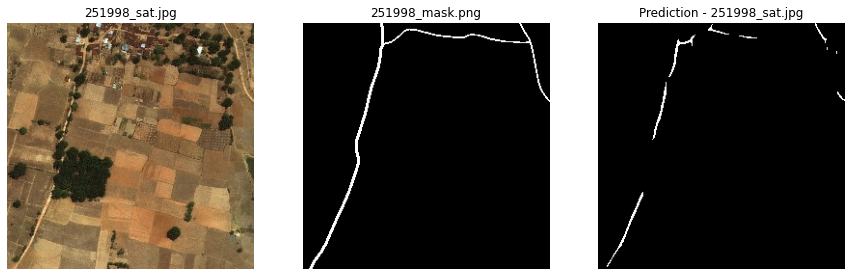

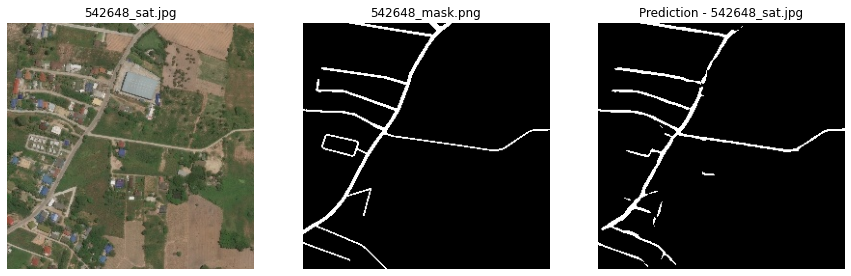

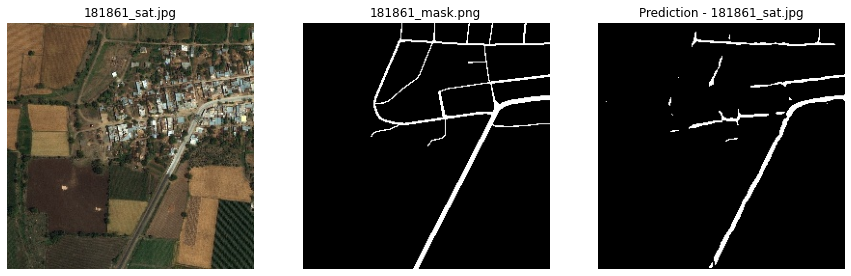

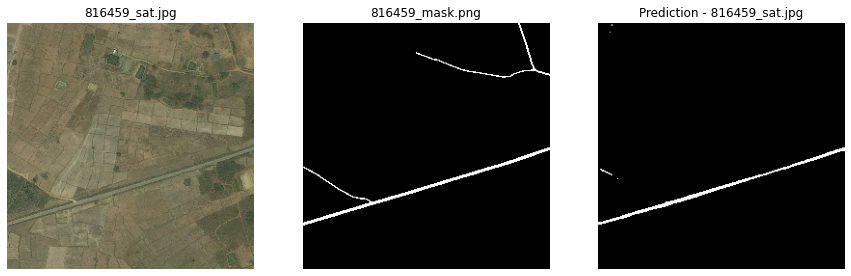

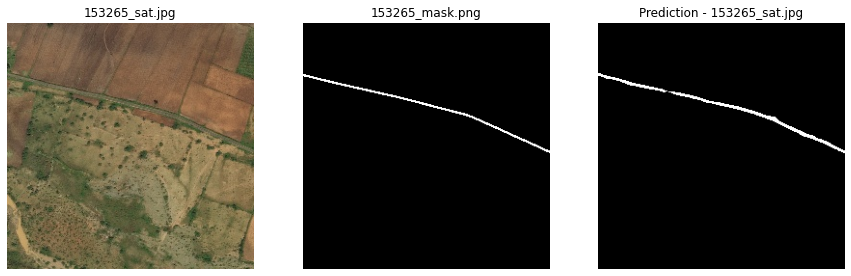

In [ ]:
m.plot_custom_valid_performance(model=model)

#### 4.2.4. Test prediction

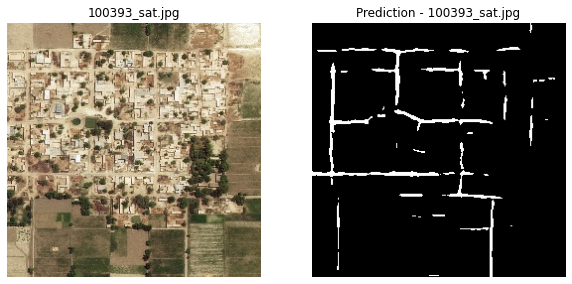

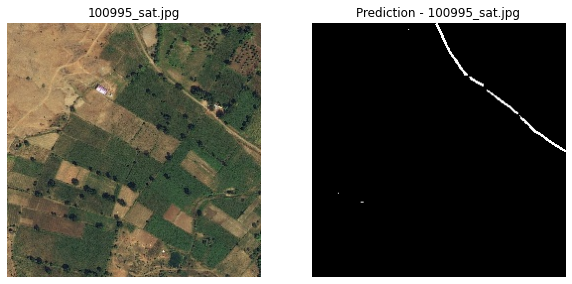

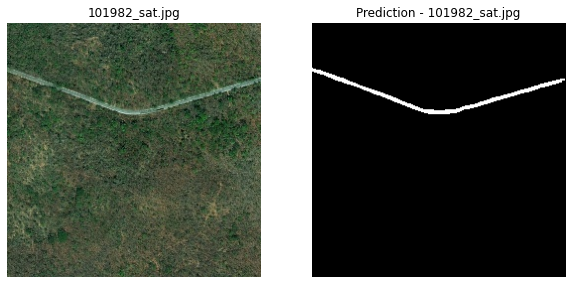

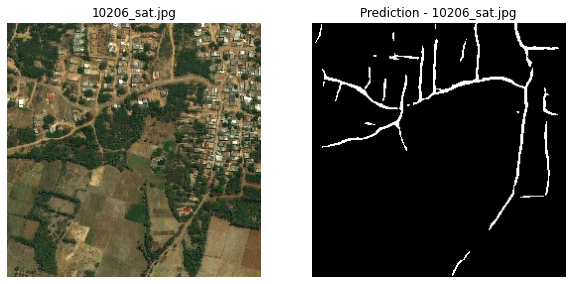

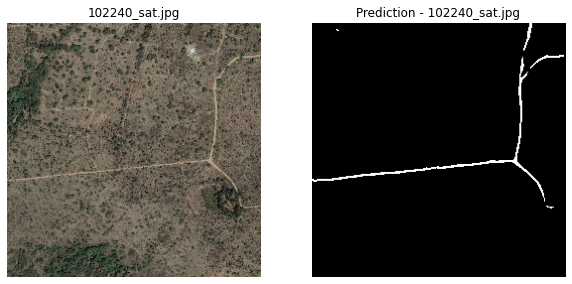

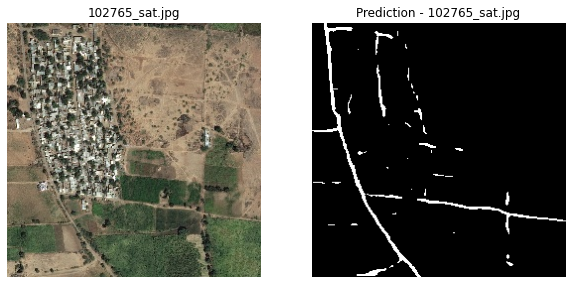

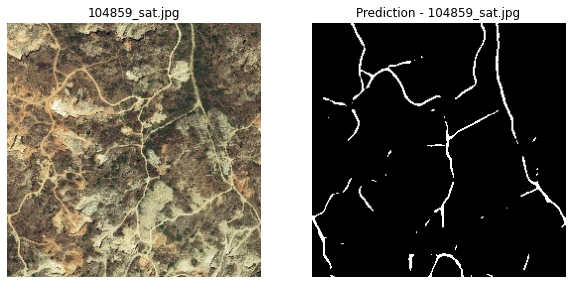

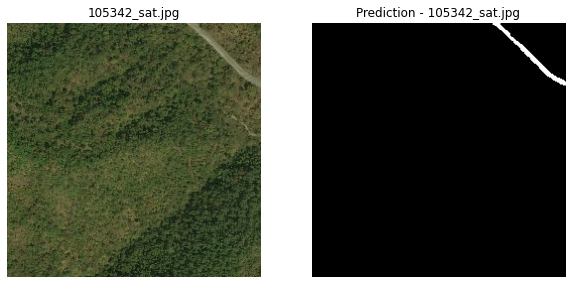

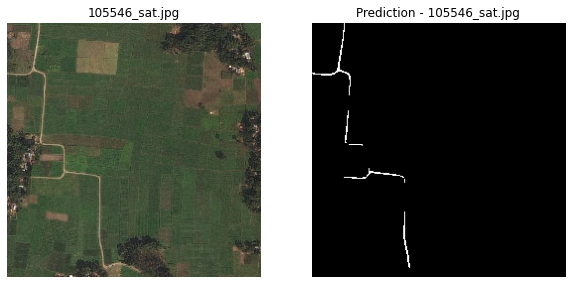

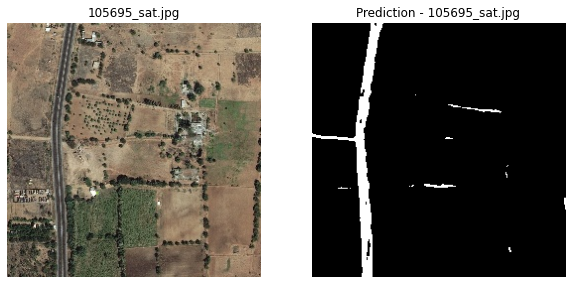

In [ ]:
m.extract_road_path(x=test_data, model=model)

### 4.3. MobileNet

#### 4.3.1. Object creation

In [ ]:
m = ModelDesign(
    train_data=train_data,
    model_name='mobilenetv2'
)

#### 4.3.2. Model training

In [ ]:
model = m.train_model()

Model is already trained and is present in directory.


<center><img src="https://user-images.githubusercontent.com/63333753/153406022-8c5555f6-329e-40b0-81ea-98c57f19916f.png"></center>

#### 4.3.3. Valid prediction

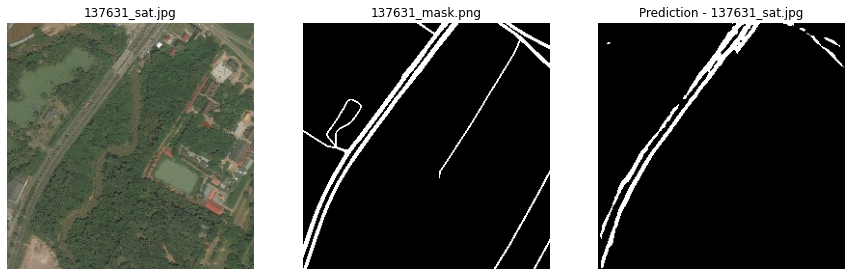

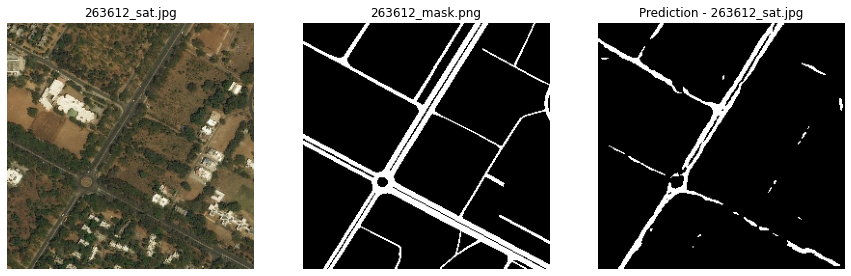

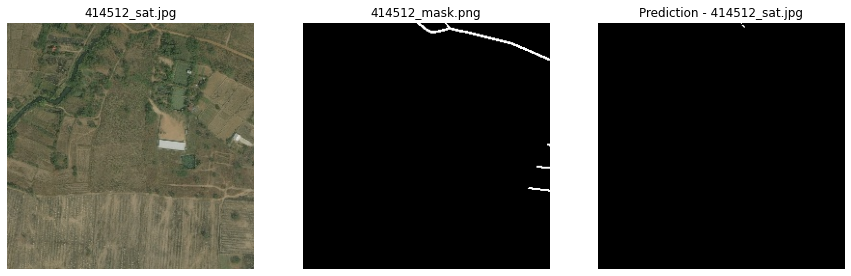

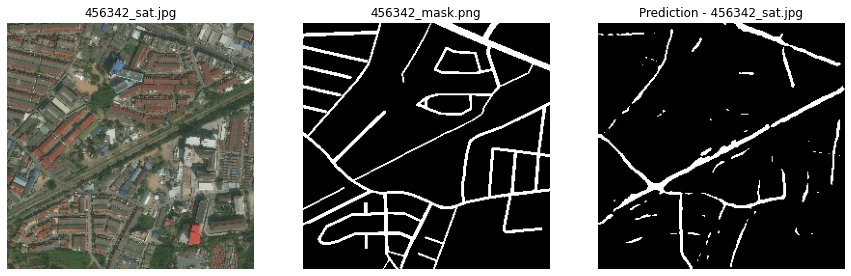

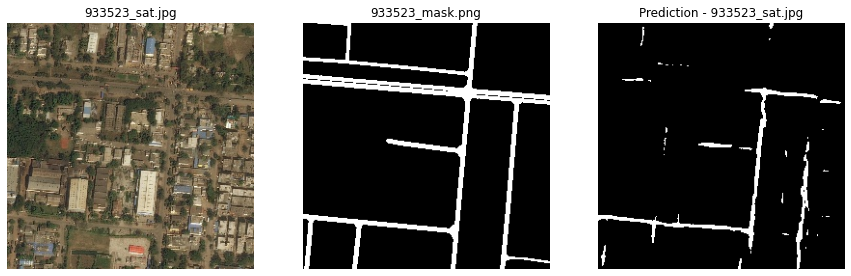

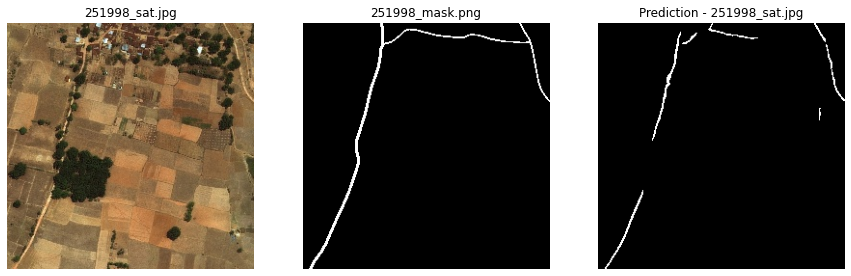

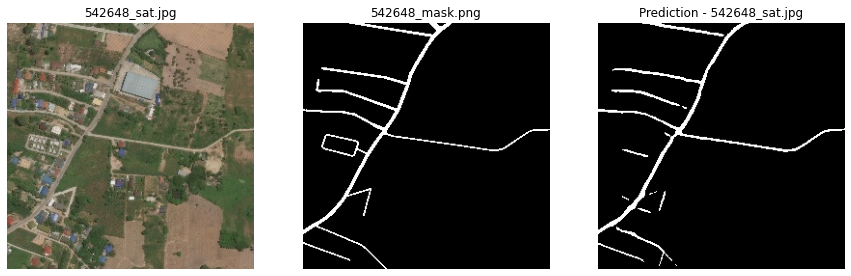

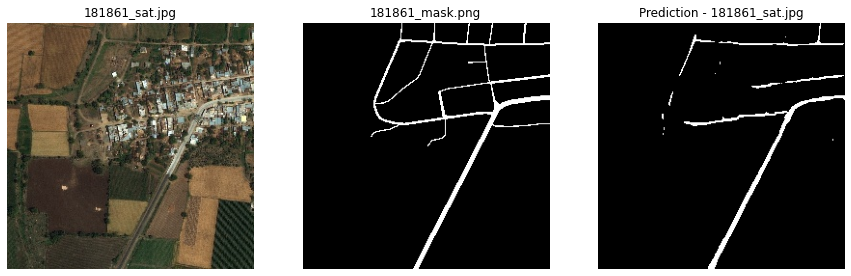

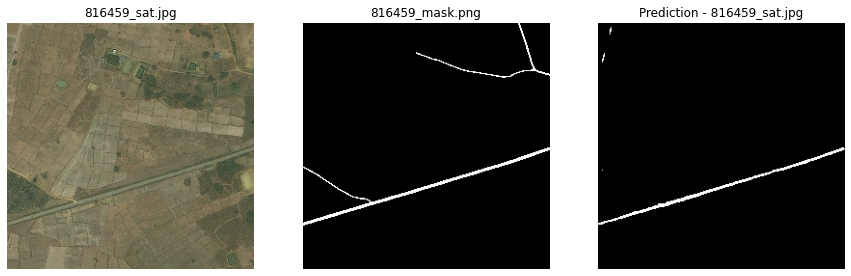

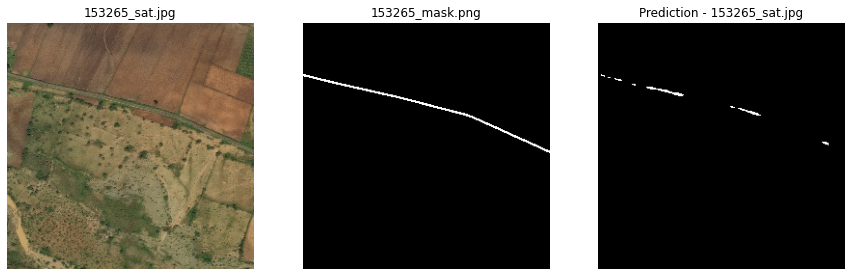

In [ ]:
m.plot_custom_valid_performance(model=model)

#### 4.3.4. Test prediction

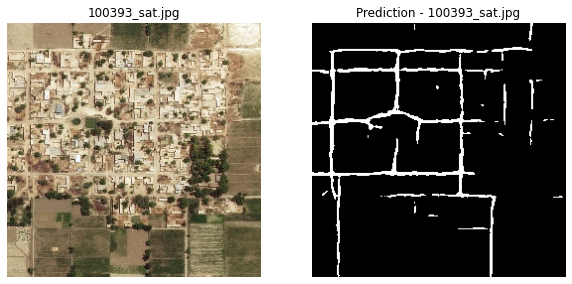

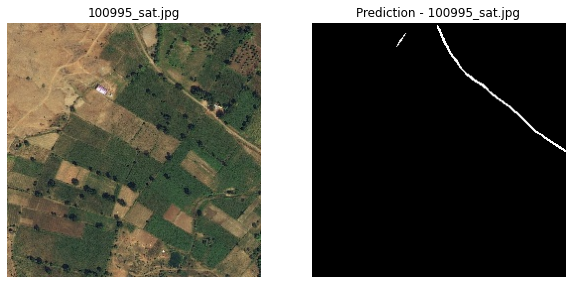

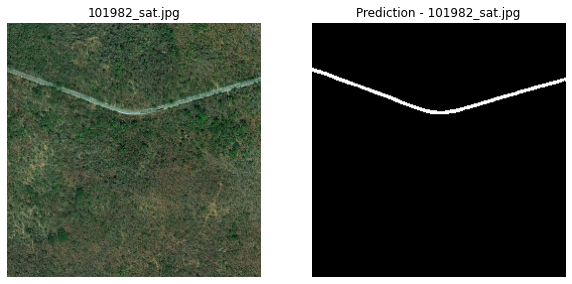

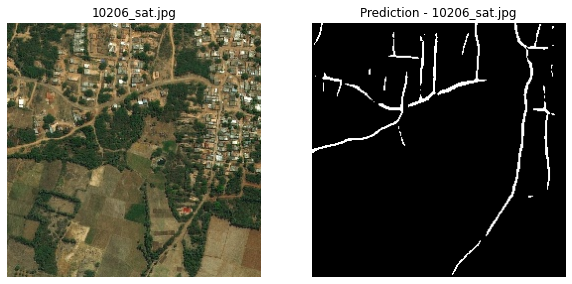

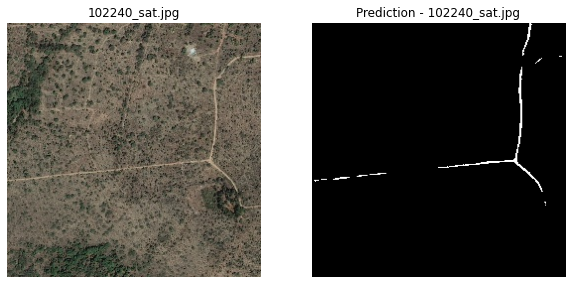

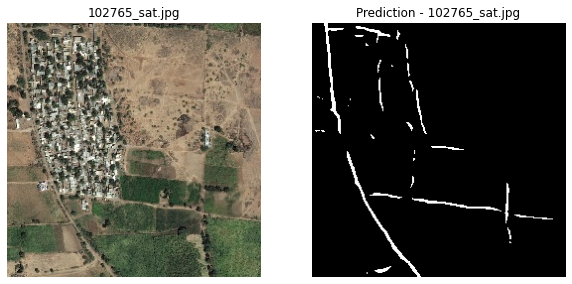

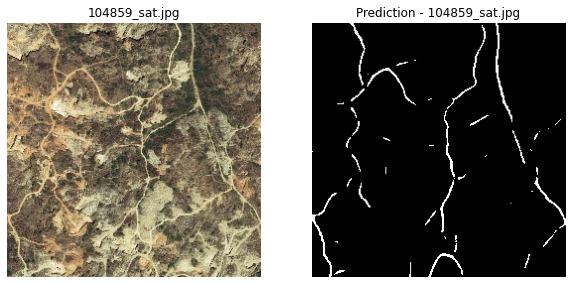

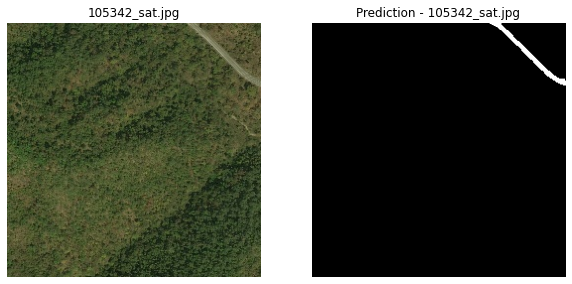

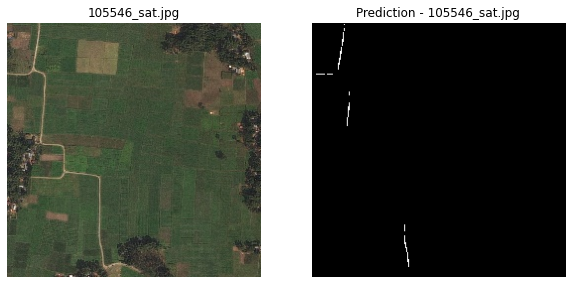

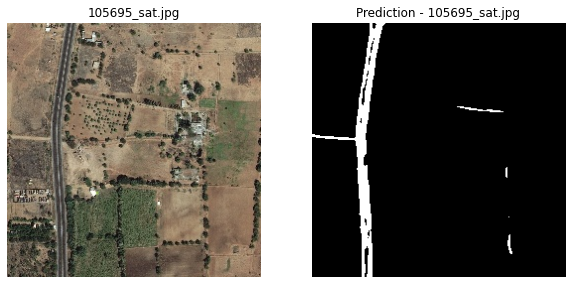

In [ ]:
m.extract_road_path(x=test_data, model=model)

### 4.4. Inception

#### 4.4.1. Object creation

In [ ]:
m = ModelDesign(
    train_data=train_data,
    model_name='inceptionv3'
)

#### 4.4.2. Model training

In [ ]:
model = m.train_model()

Model is already trained and is present in directory.


<center><img src="https://user-images.githubusercontent.com/63333753/153411831-bce18084-ff30-42b3-a900-afcf665ccfba.png"></center>

#### 4.4.3. Valid prediction

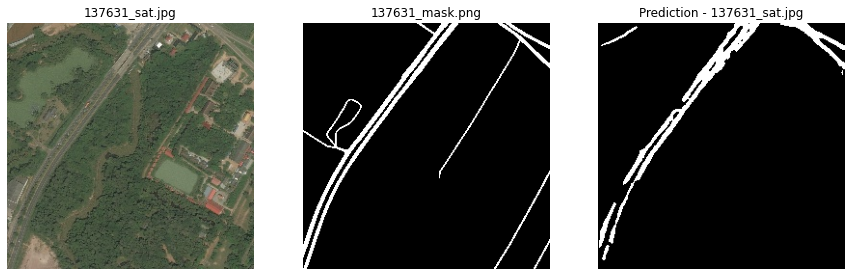

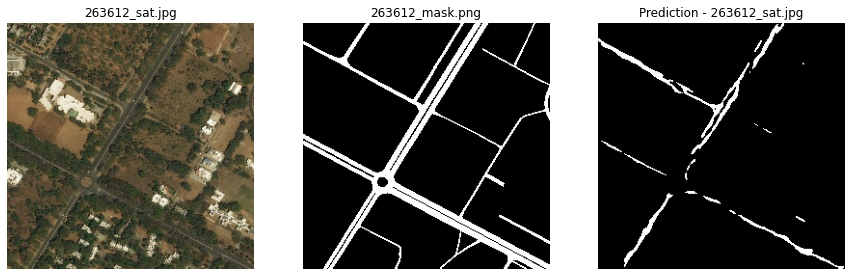

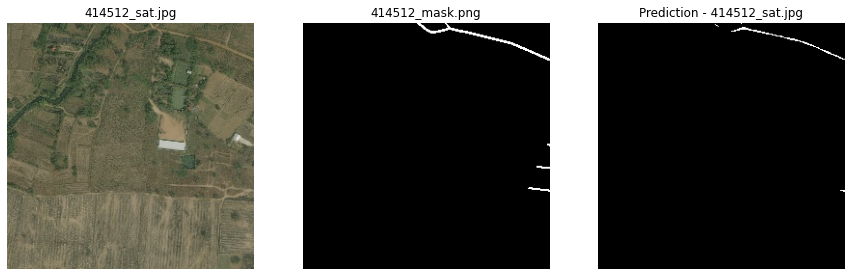

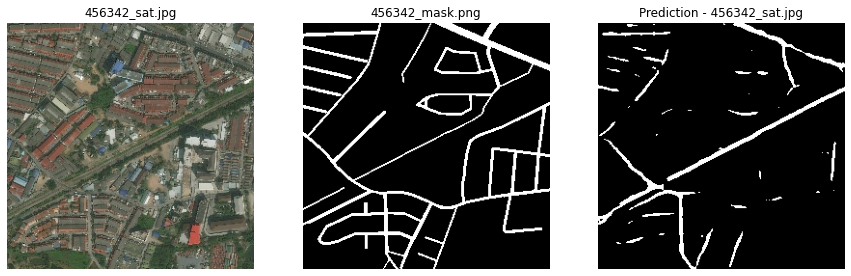

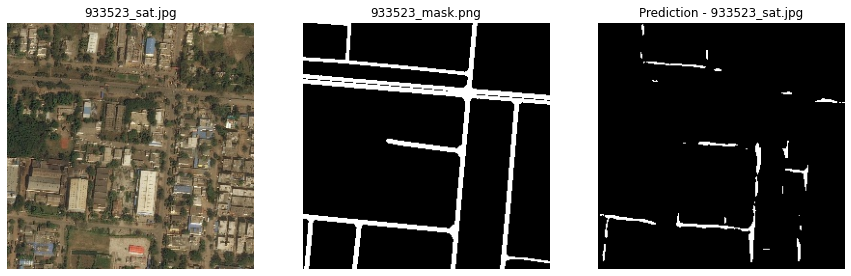

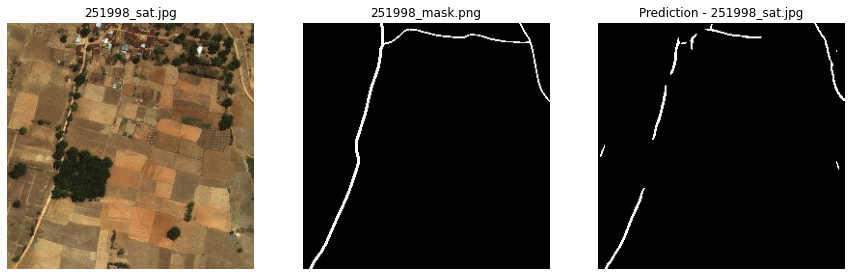

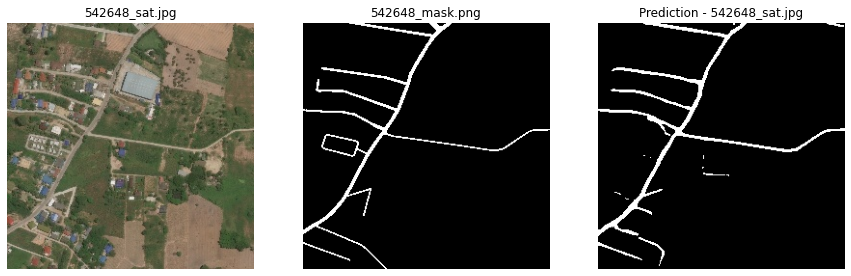

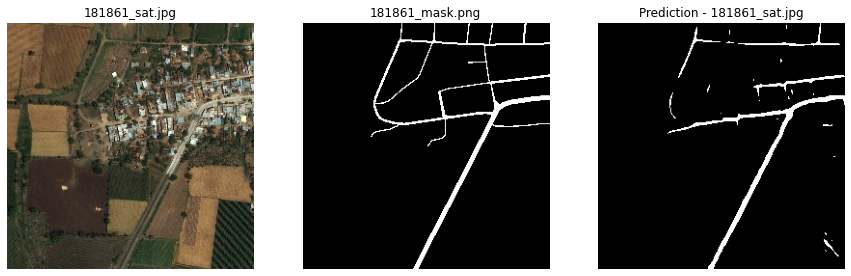

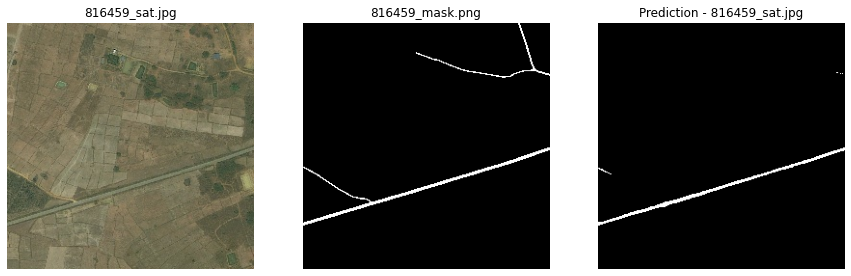

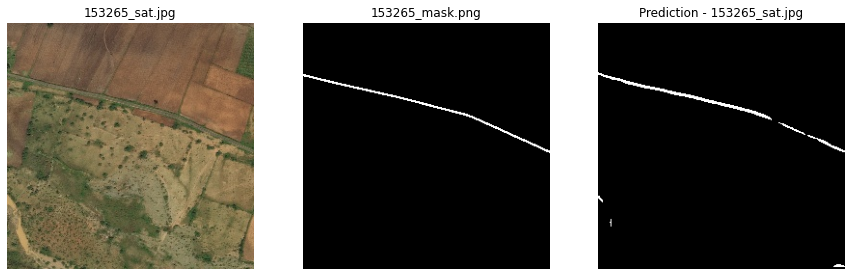

In [ ]:
m.plot_custom_valid_performance(model=model)

#### 4.4.4. Test prediction

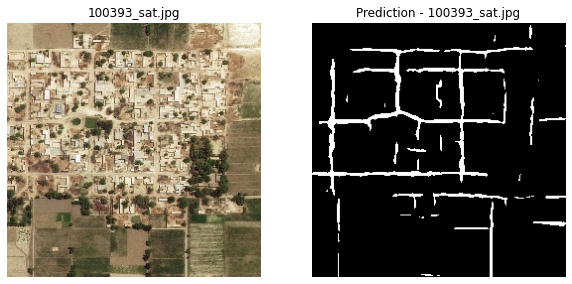

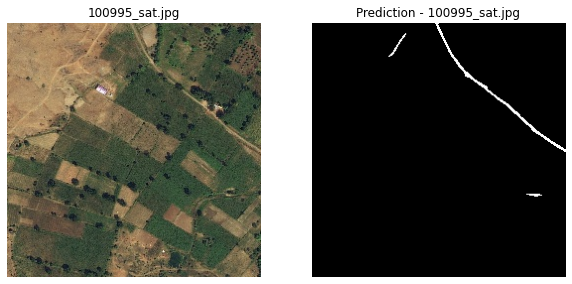

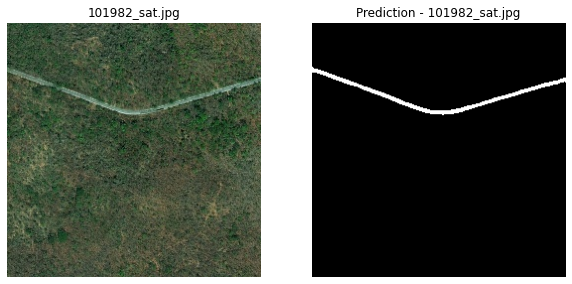

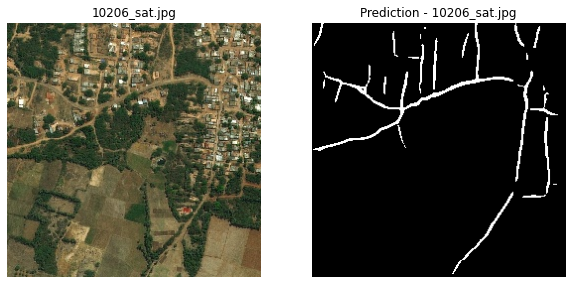

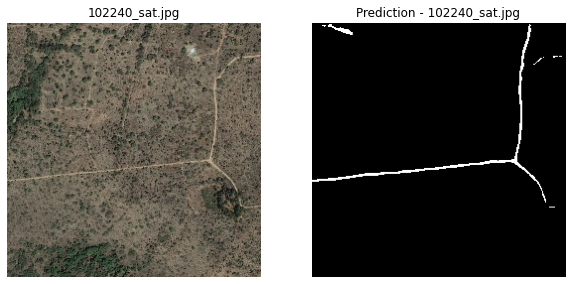

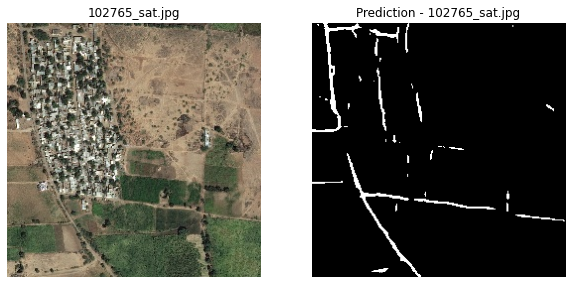

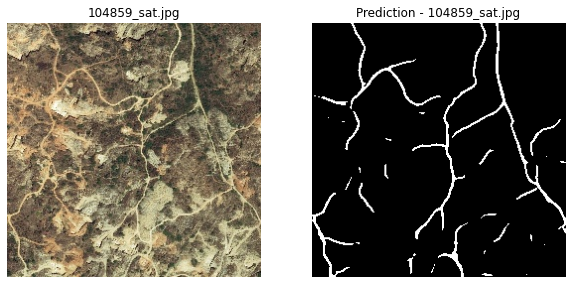

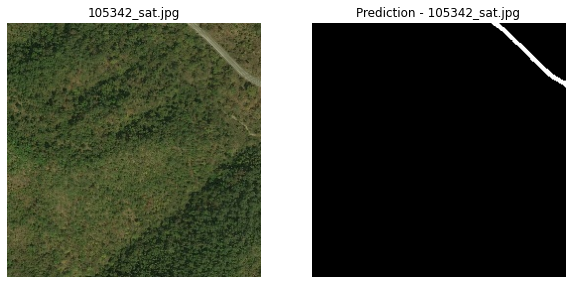

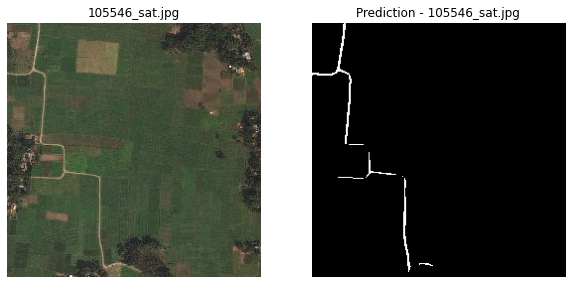

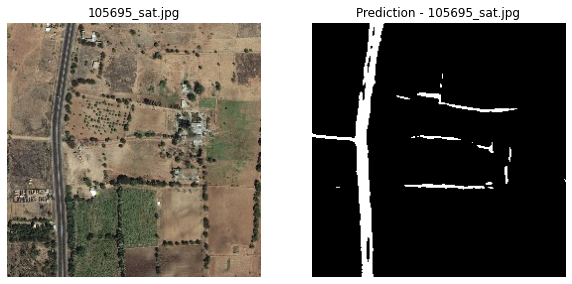

In [ ]:
m.extract_road_path(x=test_data, model=model)

### 4.5. ResNet50

#### 4.5.1. Object creation

In [ ]:
m = ModelDesign(
    train_data=train_data,
    model_name='resnet50'
)

#### 4.5.2. Model training

In [ ]:
model = m.train_model()

Model is already trained and is present in directory.


<center><img src="https://user-images.githubusercontent.com/63333753/153416462-80b1d4e6-da4e-433d-a040-73e19b958761.png"></center>

#### 4.5.3. Valid prediction

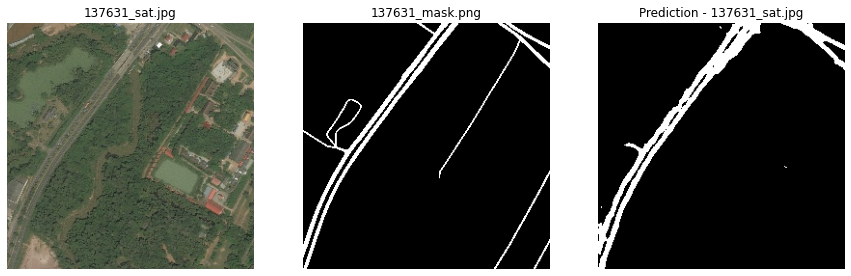

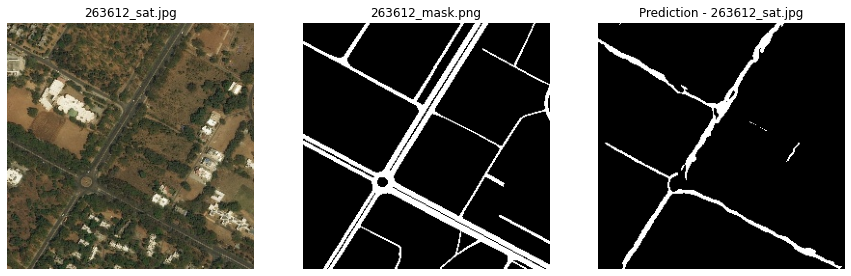

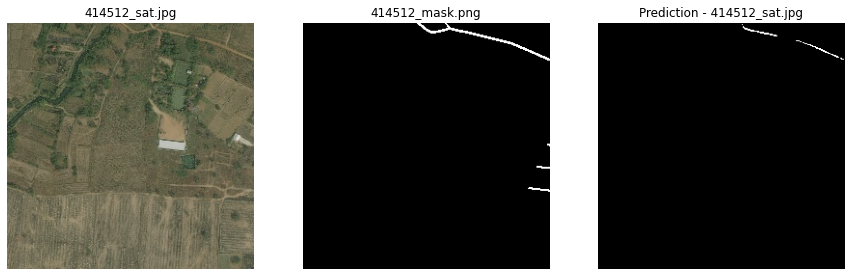

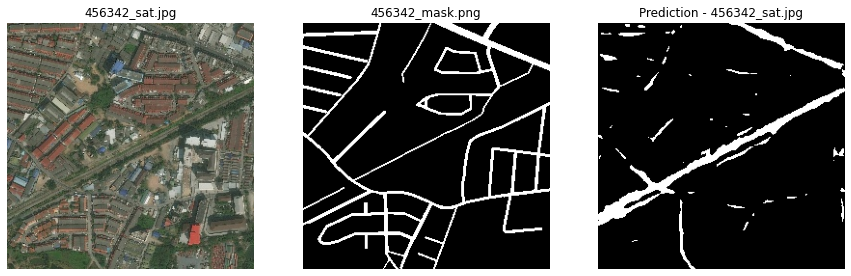

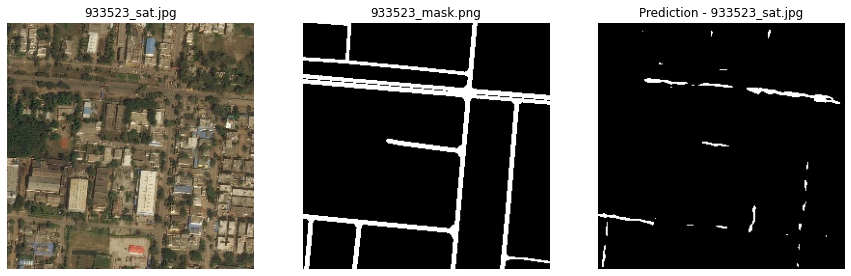

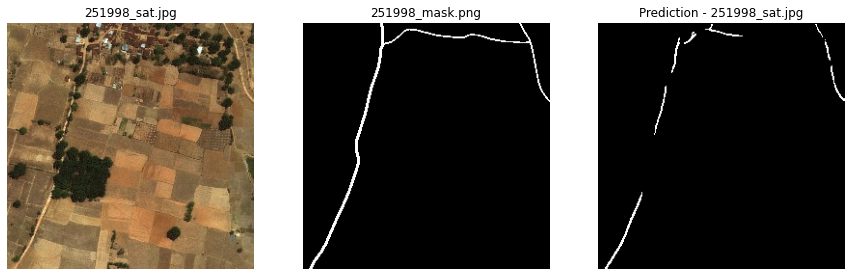

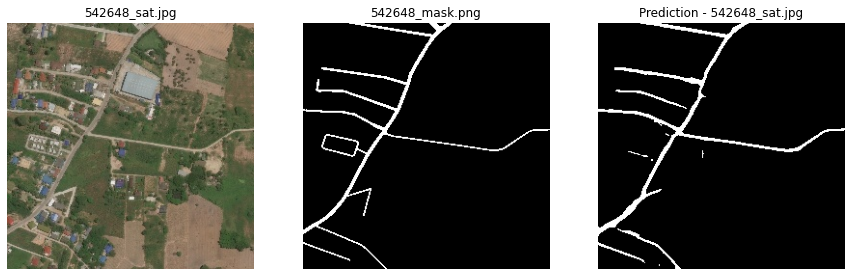

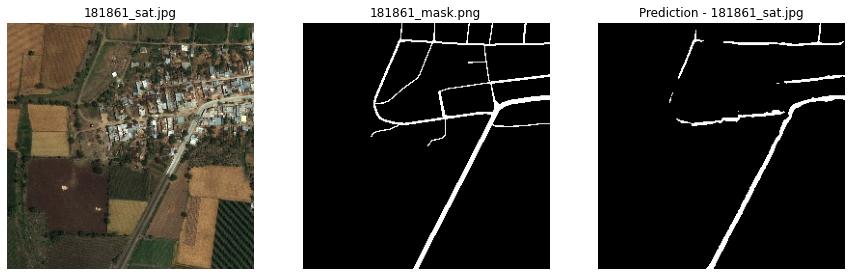

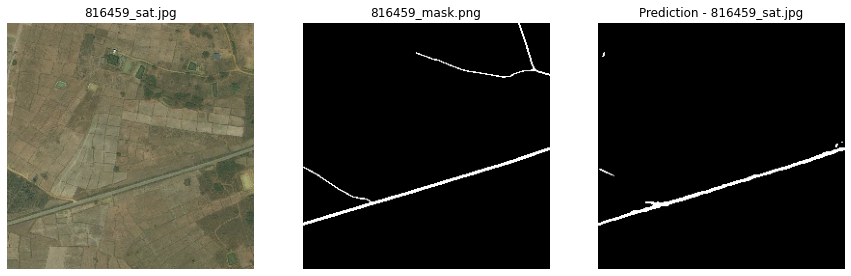

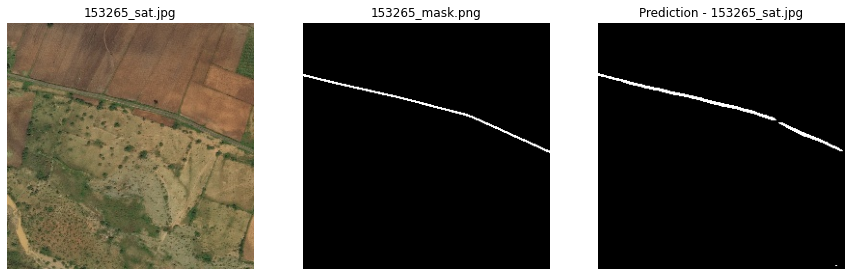

In [ ]:
m.plot_custom_valid_performance(model=model)

#### 4.5.4. Test prediction

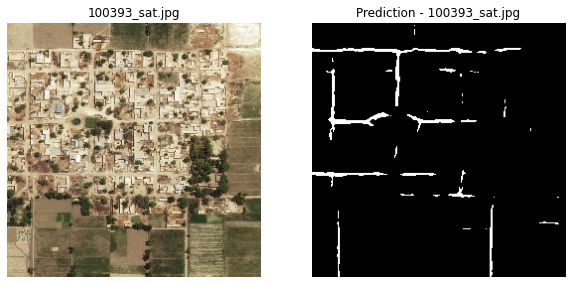

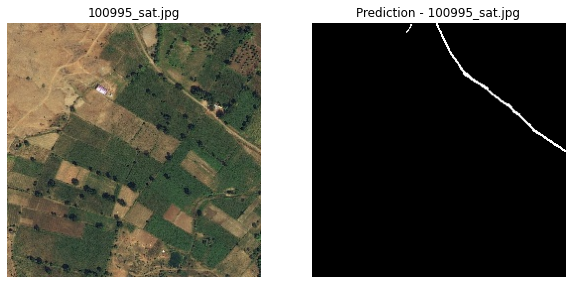

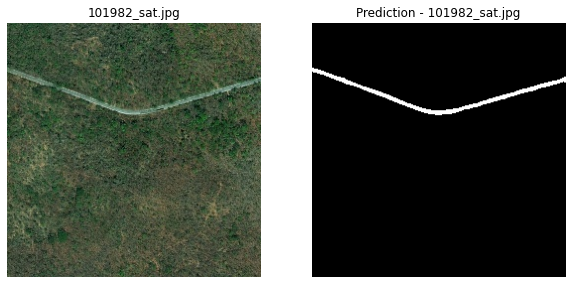

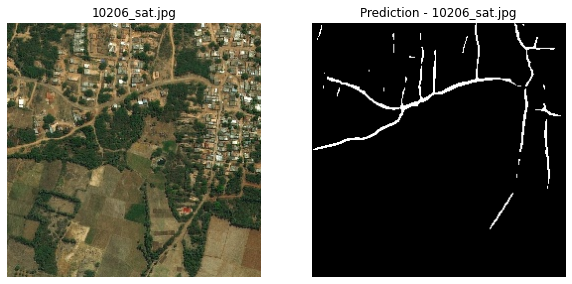

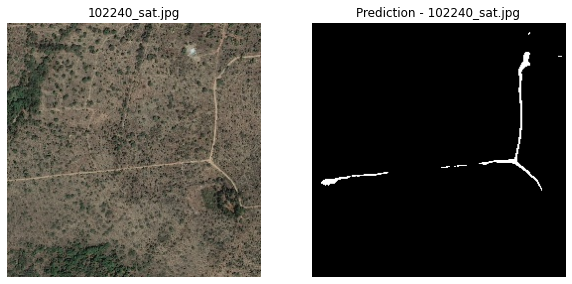

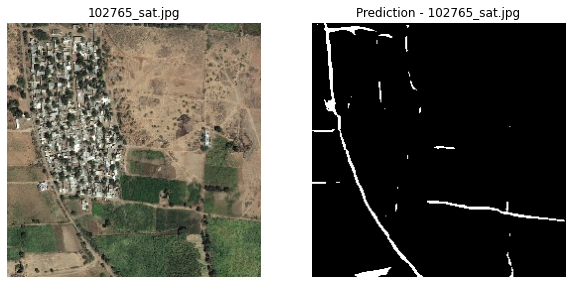

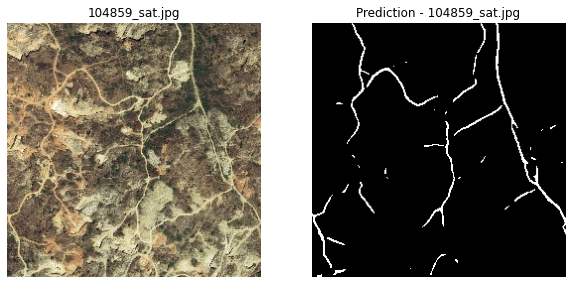

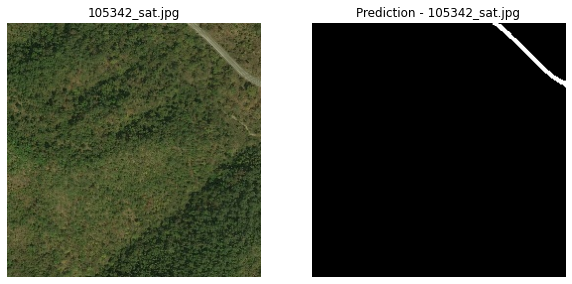

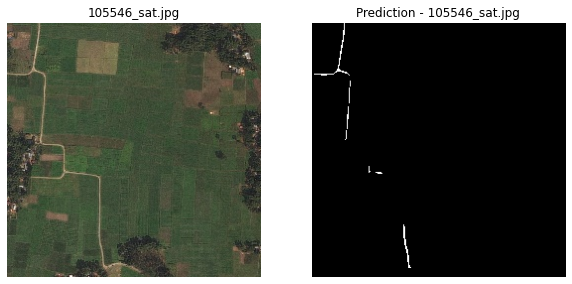

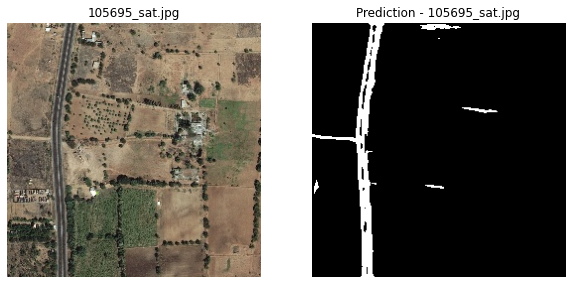

In [ ]:
m.extract_road_path(x=test_data, model=model)

### 4.6. EfficientNet

#### 4.6.1. Object creation

In [ ]:
# m = ModelDesign(
#     train_data=train_data,
#     model_name='efficientnetb0'
# )

#### 4.6.2. Model training

In [ ]:
# model = m.train_model()

#### 4.6.3. Valid prediction

In [ ]:
# m.plot_custom_valid_performance(model=model)

#### 4.6.4. Test prediction

In [ ]:
# m.extract_road_path(x=test_data, model=model)

## 5. Data Generator (Augmentation)

Image augmentation

In [ ]:
aug2 = iaa.Fliplr(1)
aug3 = iaa.Flipud(1)
aug4 = iaa.Emboss(alpha=(1), strength=1)
aug5 = iaa.DirectedEdgeDetect(alpha=(0.8), direction=(1.0))
aug6 = iaa.Sharpen(alpha=(1.0), lightness=(1.5))

In [ ]:
class DatasetAugment:
    def __init__(self, df):
        self.df = df

        self.w = 256
        self.h = 256
        
        # paths of images
        self.sat_images  = self.df['sat_image_path'].to_list()
    
        # paths of masked images
        self.masks_fps    = self.df['mask_path'].to_list()
    
        # labels for each class
        self.class_values = [0, 255]
    
    def __getitem__(self, i):
        
        # read data
        image = cv.imread('/content/DeepGlobe/' + self.sat_images[i], cv.IMREAD_UNCHANGED)
        image = cv.cvtColor(image, cv.COLOR_BGR2RGB)

        image_mask  = cv.imread('/content/DeepGlobe/' + self.masks_fps[i], cv.IMREAD_UNCHANGED)
        image_mask = image_mask[:,:,0]
        image_masks = [(image_mask == v) for v in self.class_values]
        image_mask = np.stack(image_masks, axis=-1).astype('float')

        a = np.random.uniform()
        if (a < 0.2):
            image = aug2.augment_image(image)
            image_mask = aug2.augment_image(image_mask)
        elif (a < 0.4):
            image = aug3.augment_image(image)
            image_mask = aug3.augment_image(image_mask)
        elif (a < 0.6):
            image = aug4.augment_image(image)
            image_mask = aug4.augment_image(image_mask)
        elif (a < 0.8):
            image = aug5.augment_image(image)
            image_mask = aug5.augment_image(image_mask)
        else:
            image = aug6.augment_image(image)
            image_mask = aug6.augment_image(image_mask)
            
        return image, image_mask
    
    def __len__(self):
        return len(self.df)

In [ ]:
class DataLoderAugment(tf.keras.utils.Sequence):    
    def __init__(self, dataset, batch_size=1, shuffle=False):
        self.dataset = dataset
        self.batch_size = batch_size
        self.shuffle = shuffle
        self.indexes = np.arange(len(dataset))

    def __getitem__(self, i):
        # collect batch data
        start = i * self.batch_size
        stop = (i + 1) * self.batch_size
        
        data = []
        for j in range(start, stop):
            data.append(self.dataset[j])
        
        batch = [np.stack(samples, axis=0) for samples in zip(*data)]
        
        return tuple(batch)
    
    def __len__(self):
        return len(self.indexes) // self.batch_size
    
    def on_epoch_end(self):
        if self.shuffle:
            self.indexes = np.random.permutation(self.indexes)

## 6. Segmentation Models

Data is augmentated

In [ ]:
class ModelDesignAugmetation:
    def __init__(self, train_data, model_name):
        self.width = 256
        self.height = 256
        
        self.train_data = train_data

        # base model from segmentation models
        self.model_name = model_name
    
    def _get_model(self):
        model = Unet(
            backbone_name=self.model_name, 
            encoder_weights='imagenet', 
            classes=2, 
            activation='softmax', 
            input_shape=(self.width, self.height, 3), 
            encoder_freeze=True
        )
        return model
    
    def _plot_xy(self, x, y1, y2, yl, xl='epochs'):
        plt.plot(x, y1, label='train')
        plt.plot(x, y2, label='validation')
        plt.xlabel(xl)
        plt.ylabel(yl)
        plt.title('Train VS Validation')
        plt.legend()
        plt.show()
        return None
    
    def _plot_performance(self, tracker, epochs):
        x = list(range(1, epochs + 1))

        train_iou = tracker.history['iou_score']
        valid_iou = tracker.history['val_iou_score']

        train_loss = tracker.history['loss']
        valid_loss = tracker.history['val_loss']

        self._plot_xy(x=x, y1=train_iou, y2=valid_iou, yl='iou_score')
        self._plot_xy(x=x, y1=train_loss, y2=valid_loss, yl='loss')

        return None
    
    def train_model(self, batch_size=1, epochs=20, show_performance=True):
        from keras.callbacks import ModelCheckpoint, EarlyStopping

        model = self._get_model()

        # since the original validation data does not have masks
        # i am considering `1%` of `train_data` as the `custom_validation`
        # in order to keep track of the model's performance
        self.custom_train, self.custom_valid = train_test_split(self.train_data, test_size=0.1, random_state=42)

        train_dataset = DatasetAugment(df=self.custom_train)
        valid_dataset = DatasetAugment(df=self.custom_valid)

        train_dataloader = DataLoderAugment(train_dataset, batch_size=batch_size, shuffle=True)
        valid_dataloader = DataLoderAugment(valid_dataset, batch_size=batch_size, shuffle=True)

        optimizer = tf.keras.optimizers.Adam(0.001)

        # cce_dice_loss = categorical_crossentropy + dice_loss
        focal_loss = sm.losses.cce_dice_loss

        # callbacks
        model_path = project_path + 'models/{}_augmentated.h5'.format(self.model_name)
        model_save_callback = ModelCheckpoint(
            filepath=model_path,
            save_weights_only=True,
            save_best_only=True,
            mode='max',
            monitor='val_iou_score'
        )
        early_stop_callback = EarlyStopping(monitor='val_iou_score', min_delta=0.01, patience=3, verbose=1)
        callbacks = [model_save_callback, early_stop_callback]

        model.compile(optimizer=optimizer, loss=focal_loss, metrics=[iou_score])

        if not os.path.isfile(path=model_path):
            tracker = model.fit(
                x=train_dataloader,
                steps_per_epoch=len(train_dataloader),
                epochs=epochs,
                validation_data=valid_dataloader,
                callbacks=callbacks
            )
            model.load_weights(model_path)

            if show_performance:
                self._plot_performance(tracker=tracker, epochs=len(tracker.history['iou_score']))
        
        else:
            print('Model is already trained and is present in directory.')
            model.load_weights(model_path)
        
        return model
    
    def plot_custom_valid_performance(self, model, n=10):
        vdata = self.custom_valid.head(n)
        h = self.height
        w = self.width

        # paths of images
        images_fps   = vdata['sat_image_path'].to_list()
        # paths of masked images
        masks_fps    = vdata['mask_path'].to_list()

        for oimg, mimg in zip(images_fps, masks_fps):
            # original image
            simage = cv.imread('/content/DeepGlobe/' + oimg, cv.IMREAD_UNCHANGED)
            simage = cv.cvtColor(simage, cv.COLOR_BGR2RGB)

            # mask image
            mimage = cv.imread('/content/DeepGlobe/' + mimg, cv.IMREAD_UNCHANGED)

            # prediction
            predicted_image  = model.predict(simage[np.newaxis,:,:,:])
            predicted_mask = tf.argmax(predicted_image, axis=-1)
            
            # titles
            image_title = oimg.split('/')[-1]
            mask_title = mimg.split('/')[-1]
            
            # plotting figure
            plt.figure(figsize=(15, 6))
            
            plt.subplot(131)
            plt.axis("off")
            plt.title(image_title)
            plt.imshow(simage)

            plt.subplot(132)
            plt.axis("off")
            plt.title(mask_title)
            plt.imshow(mimage)

            plt.subplot(133)
            plt.axis("off")
            plt.title("Prediction - {}".format(image_title))
            plt.imshow(predicted_mask[0], cmap='gray')
            
            plt.show()
        
        return None
    
    def extract_road_path(self, x, model, n=10):
        x_ = x.head(n)
        h = self.height
        w = self.width

        # paths of images
        images_fps   = x_['sat_image_path'].to_list()
        # paths of masked images
        masks_fps    = x_['mask_path'].to_list()

        for oimg, mimg in zip(images_fps, masks_fps):
            # original image
            image = cv.imread('/content/DeepGlobe/' + oimg, cv.IMREAD_UNCHANGED)
            image = cv.cvtColor(image, cv.COLOR_BGR2RGB)

            # prediction
            predicted_image  = model.predict(image[np.newaxis,:,:,:])
            predicted_mask = tf.argmax(predicted_image, axis=-1)
            image_title = oimg.split('/')[-1]
            
            plt.figure(figsize=(10, 6))
            
            plt.subplot(121)
            plt.axis("off")
            plt.title(image_title)
            plt.imshow(image)

            plt.subplot(122)
            plt.axis("off")
            plt.title("Prediction - {}".format(image_title))
            plt.imshow(predicted_mask[0], cmap='gray')
            
            plt.show()
        
        return None

### 6.1. ResNet34

#### 6.1.1. Object creation

In [ ]:
ma = ModelDesignAugmetation(
    train_data=train_data,
    model_name='resnet34'
)

#### 6.1.2. Model training

In [ ]:
model_a = ma.train_model()

Model is already trained and is present in directory.


<center><img src="https://user-images.githubusercontent.com/63333753/153547117-a4154b08-e045-48c7-920f-bc8c12a671a0.png"></center>

#### 6.1.3. Valid prediction

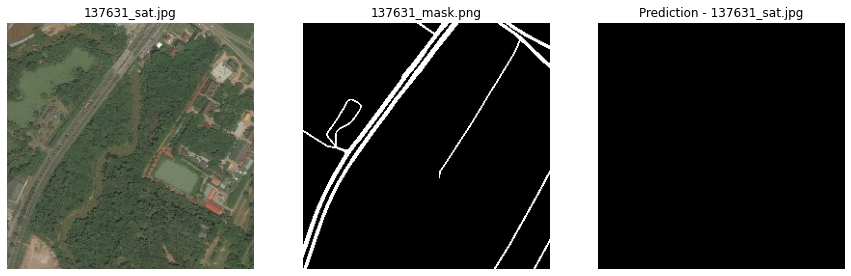

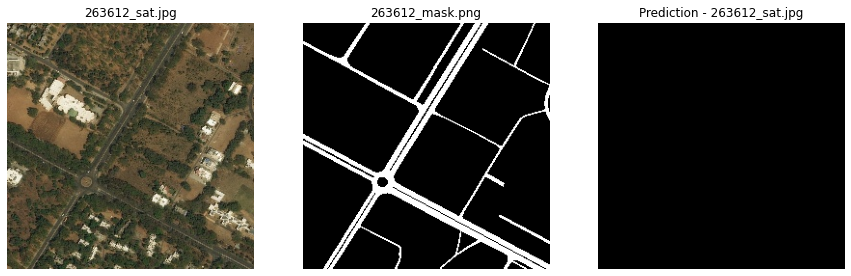

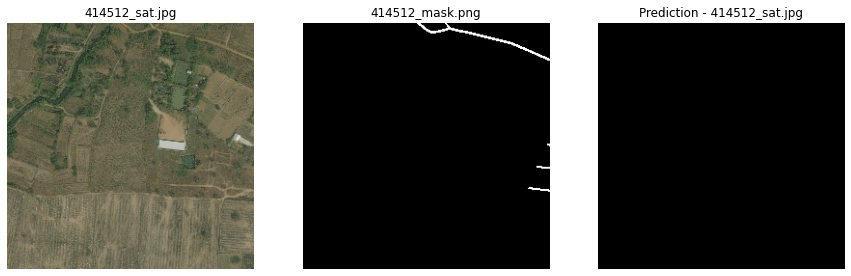

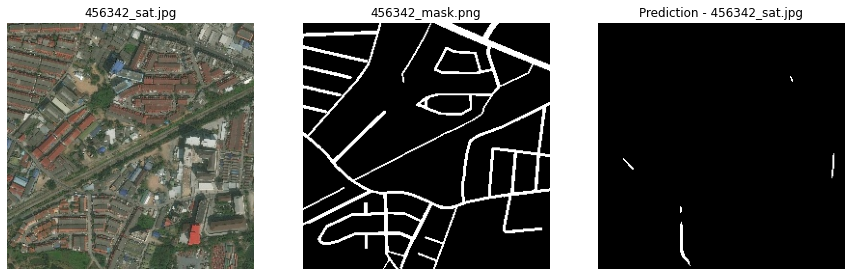

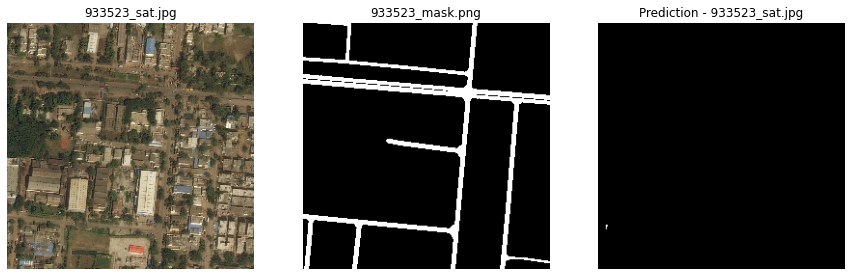

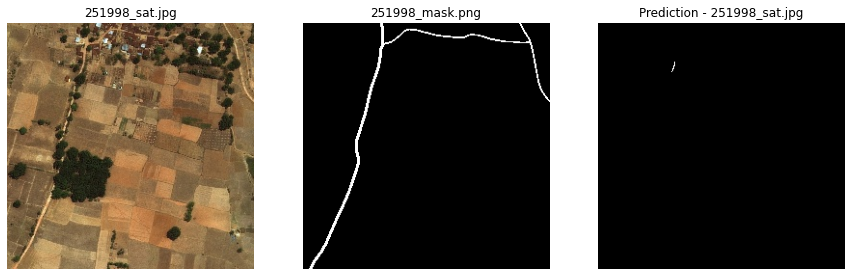

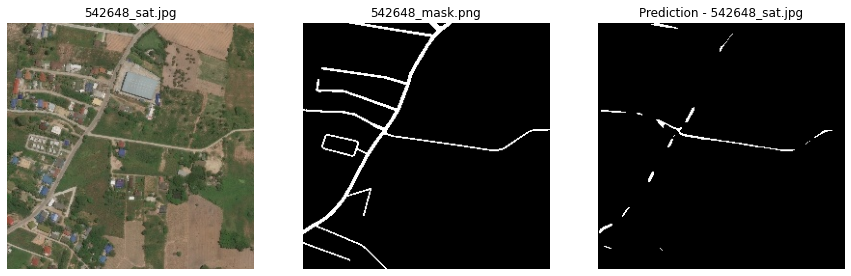

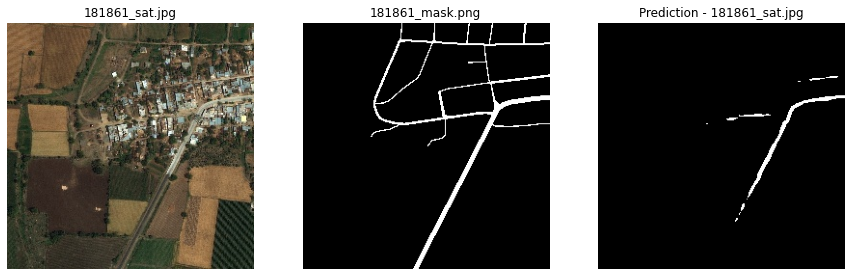

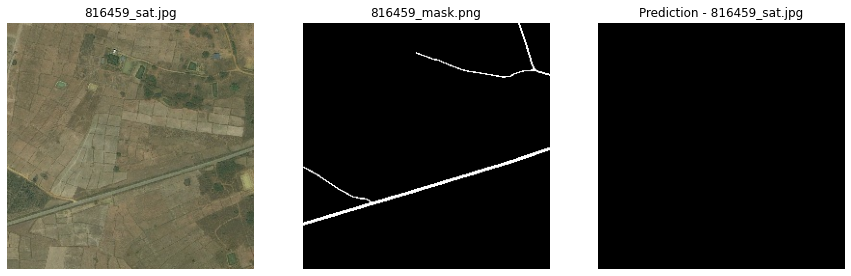

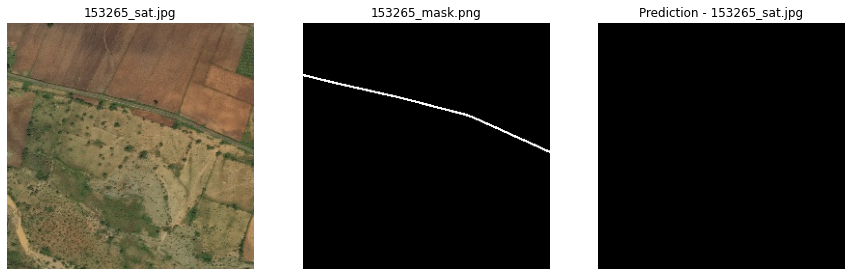

In [ ]:
ma.plot_custom_valid_performance(model=model_a)

#### 6.1.4. Test prediction

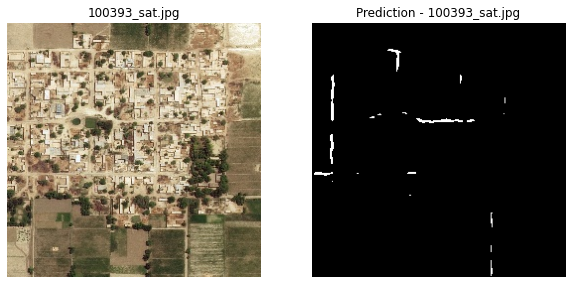

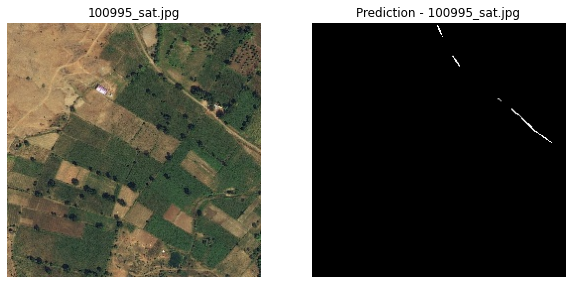

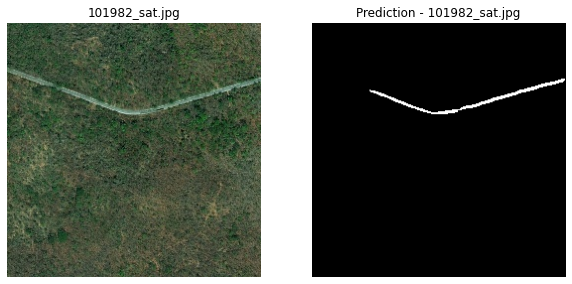

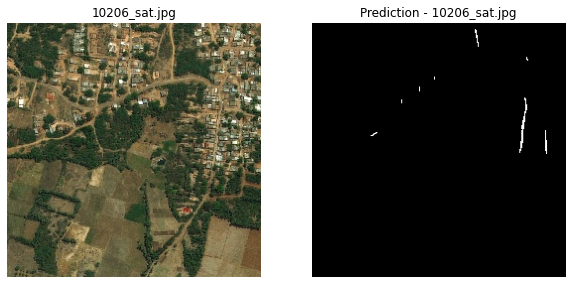

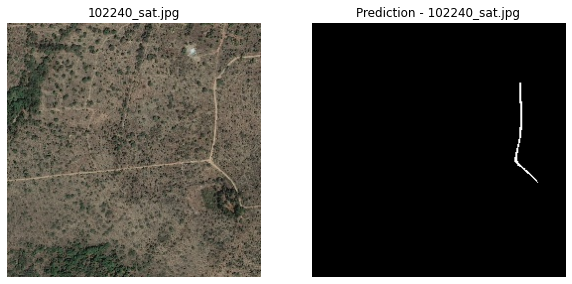

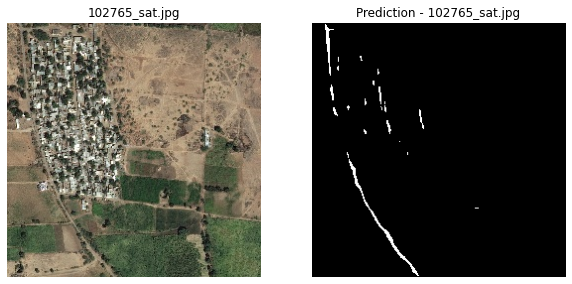

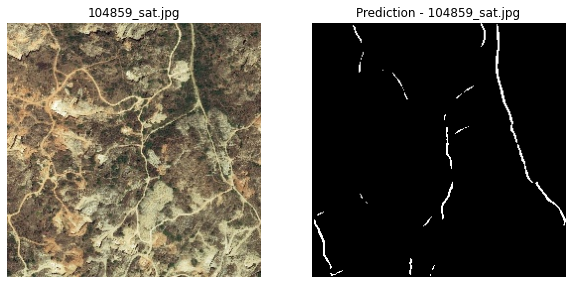

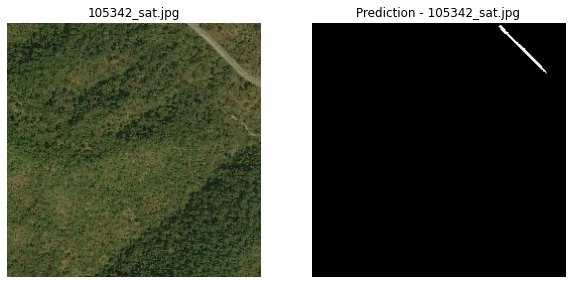

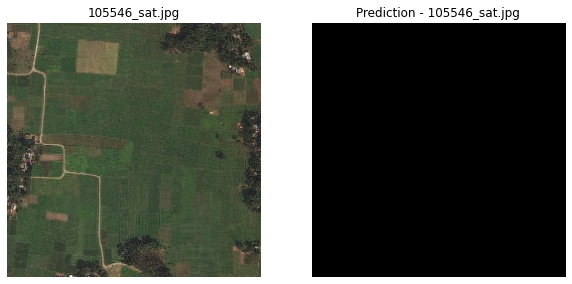

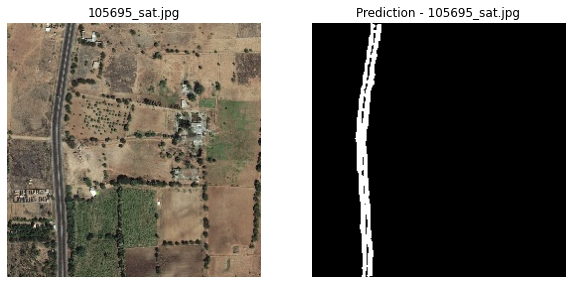

In [ ]:
ma.extract_road_path(x=test_data, model=model_a)

### 6.2. VGG16

#### 6.2.1. Object creation

In [ ]:
ma = ModelDesignAugmetation(
    train_data=train_data,
    model_name='vgg16'
)

#### 6.2.2. Model training

In [ ]:
model_a = ma.train_model()

Model is already trained and is present in directory.


<center><img src="https://user-images.githubusercontent.com/63333753/153548875-ca0dd9b4-8a4a-440a-a1a2-2387233e6462.png"></center>

#### 6.2.3. Valid prediction

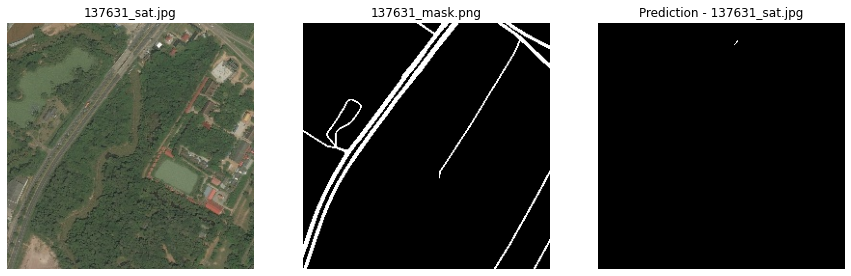

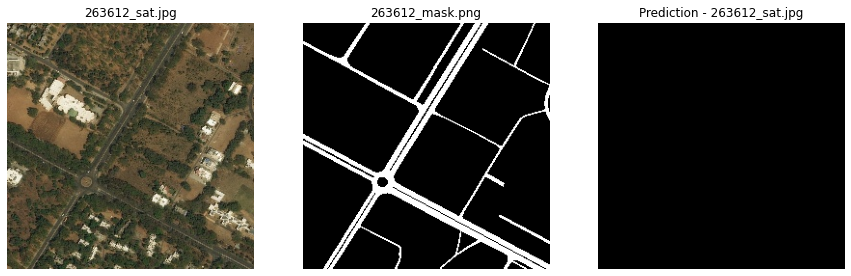

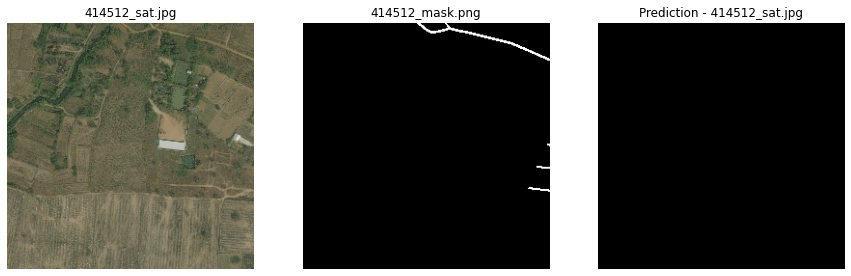

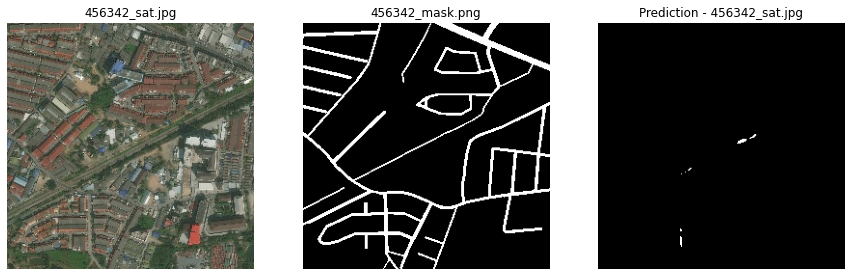

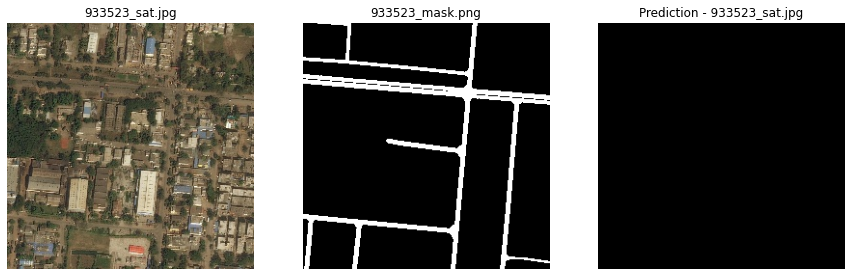

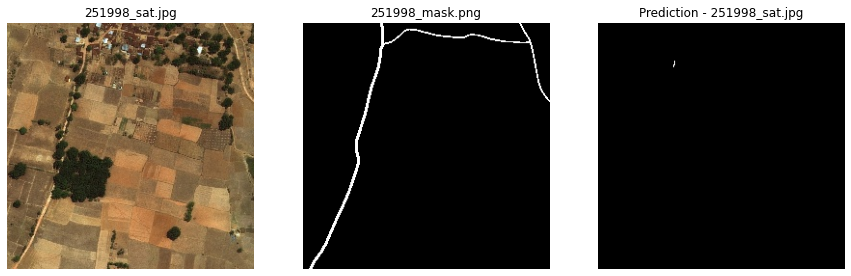

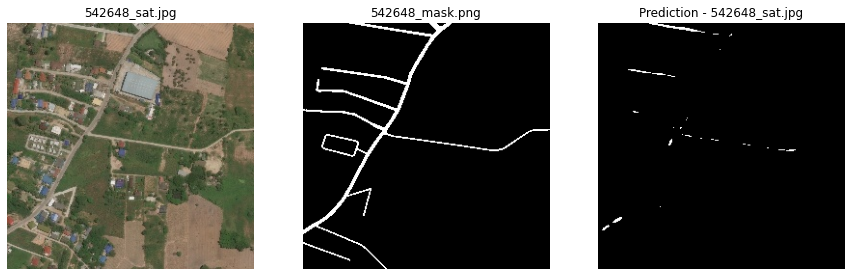

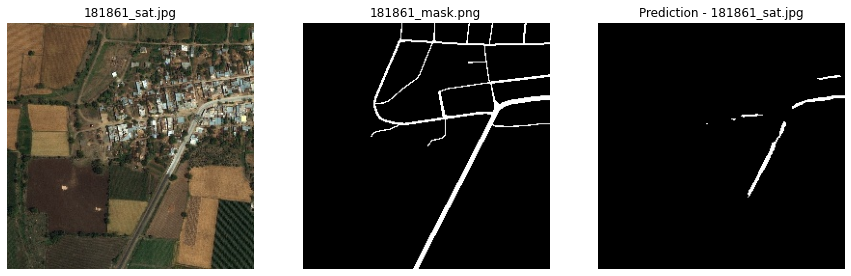

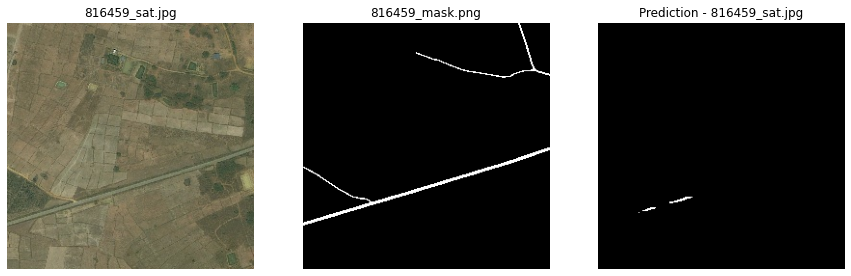

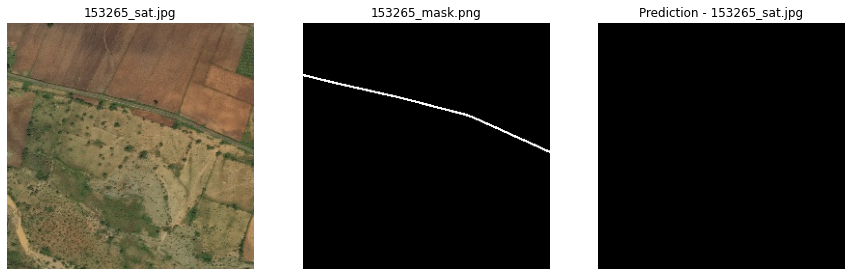

In [ ]:
ma.plot_custom_valid_performance(model=model_a)

#### 6.2.4. Test prediction

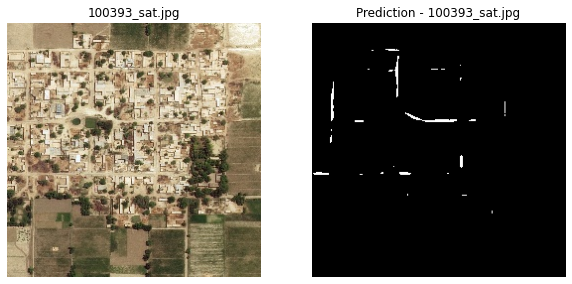

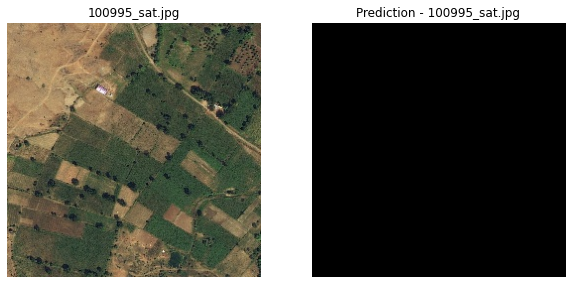

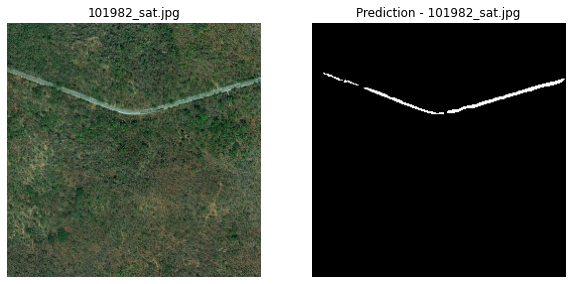

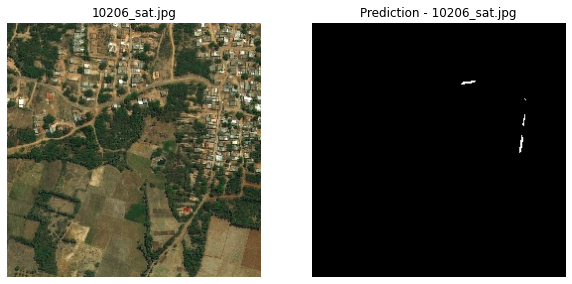

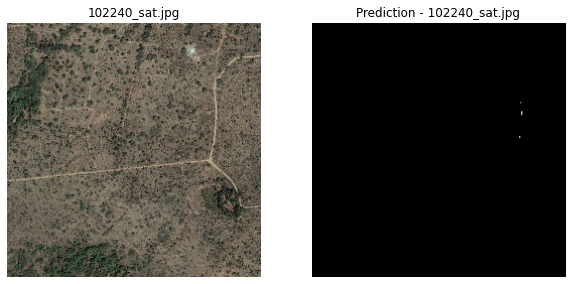

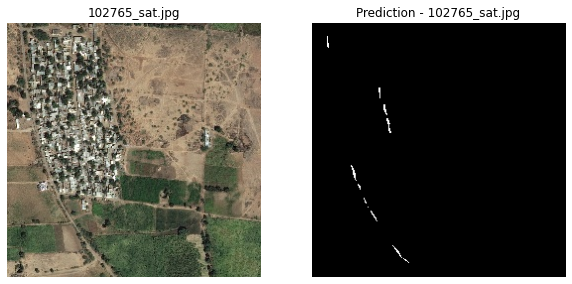

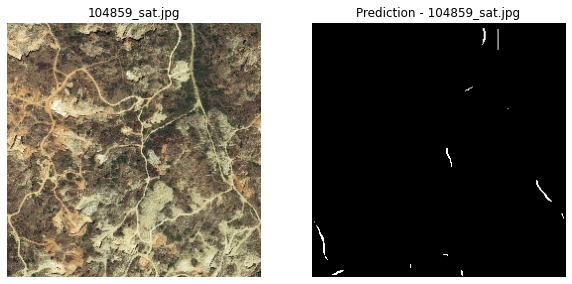

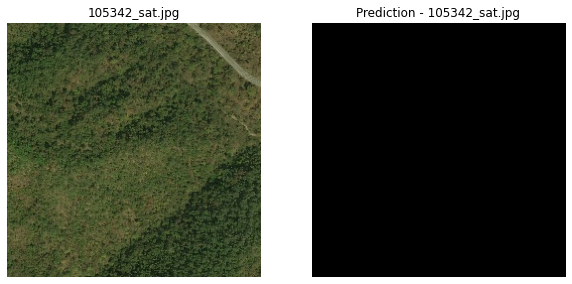

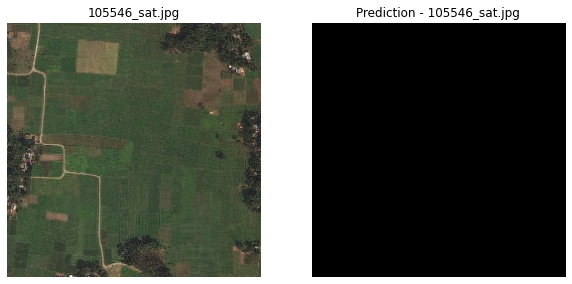

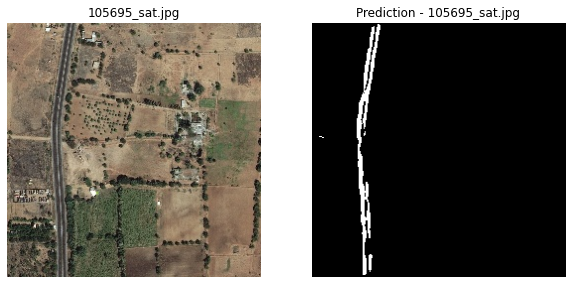

In [ ]:
ma.extract_road_path(x=test_data, model=model_a)

### 6.3. MobileNet

#### 6.3.1. Object creation

In [ ]:
ma = ModelDesignAugmetation(
    train_data=train_data,
    model_name='mobilenetv2'
)

#### 6.3.2. Model training

In [ ]:
model_a = ma.train_model()

Model is already trained and is present in directory.


<center><img src="https://user-images.githubusercontent.com/63333753/153552068-bde8608d-68d6-43f9-8f53-22248a2f0acc.png"></center>

#### 6.3.3. Valid prediction

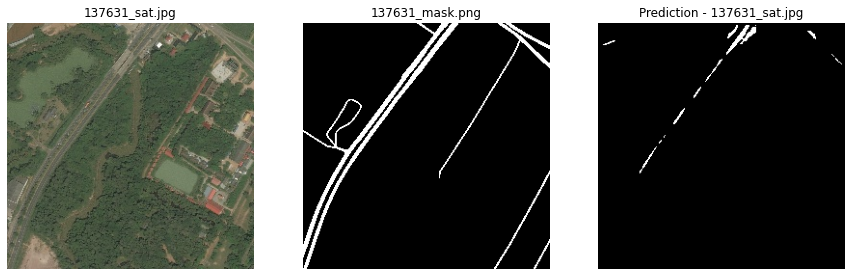

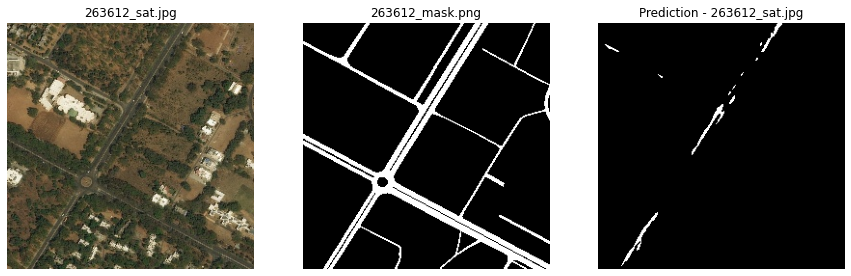

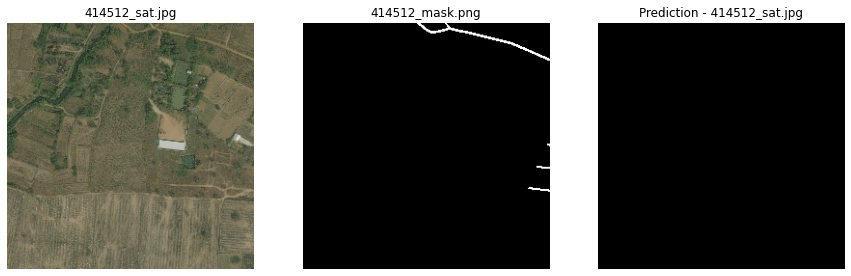

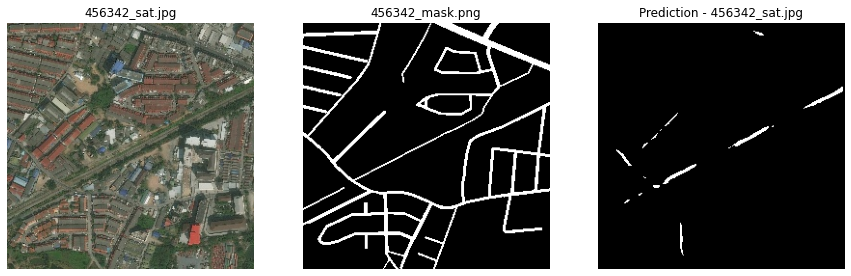

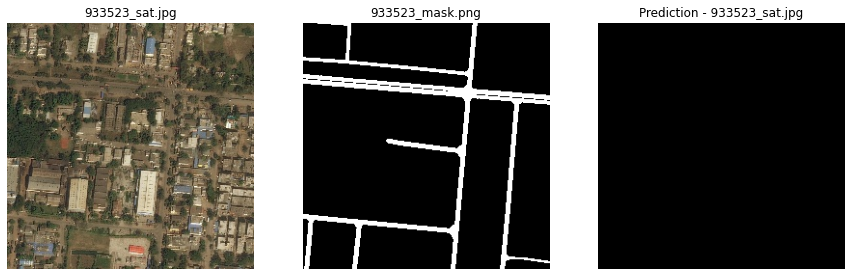

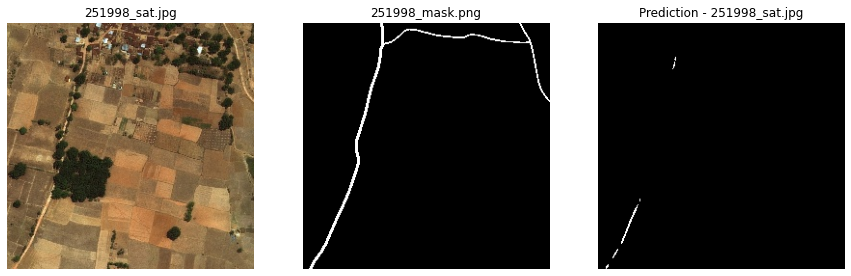

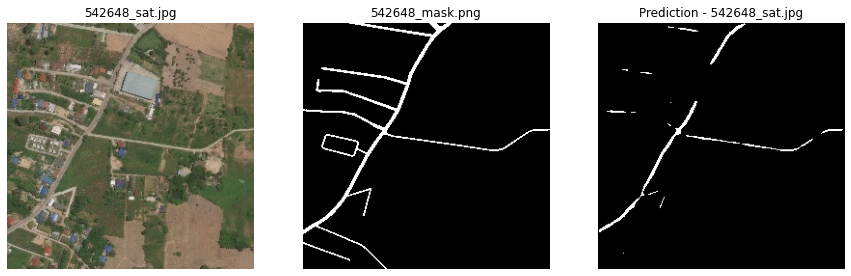

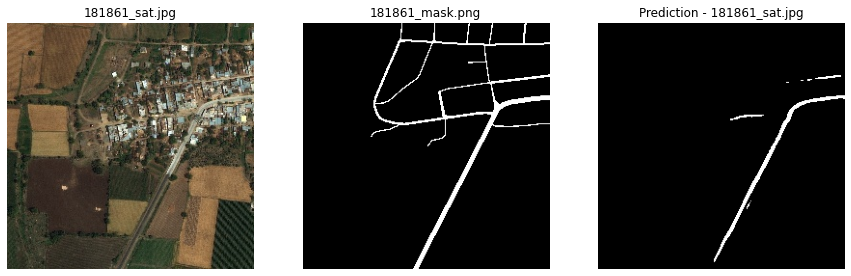

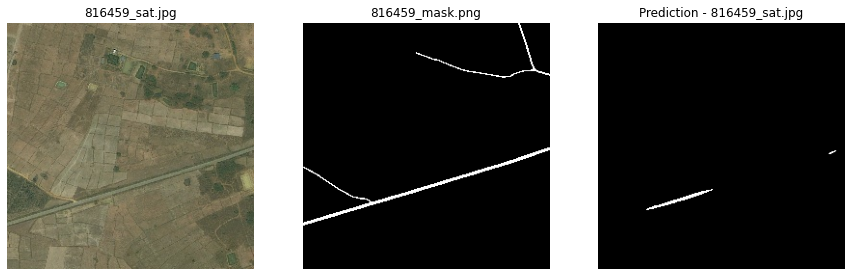

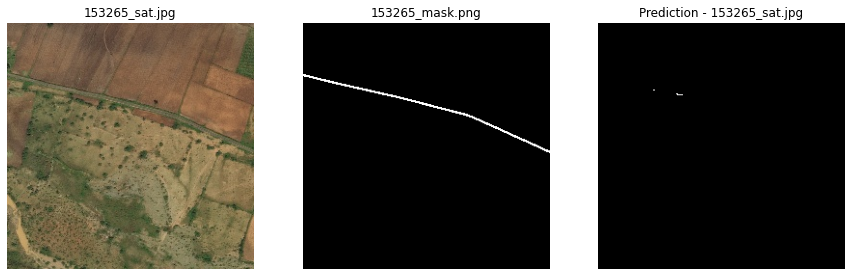

In [ ]:
ma.plot_custom_valid_performance(model=model_a)

#### 6.3.4. Test prediction

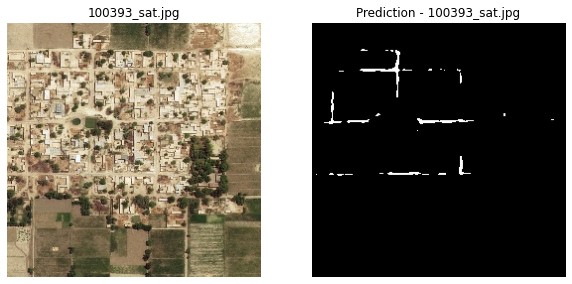

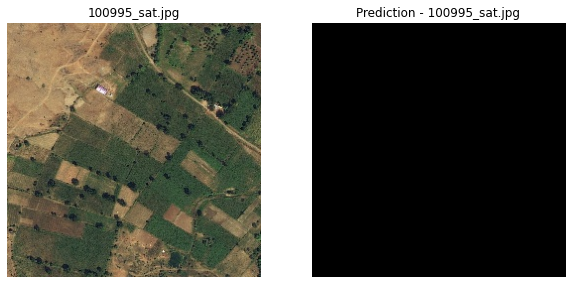

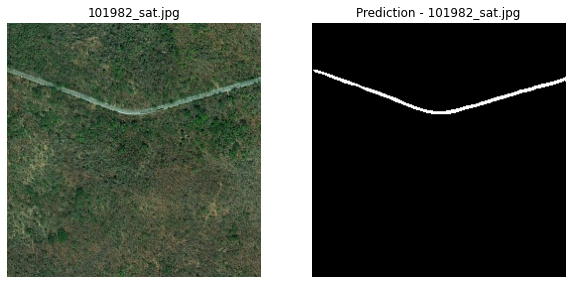

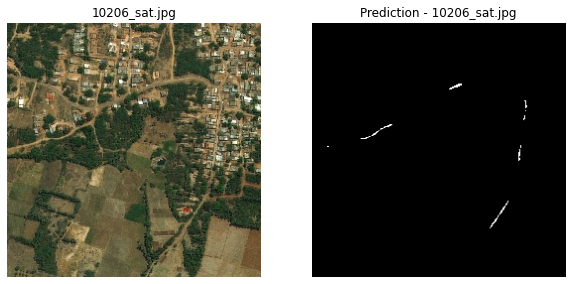

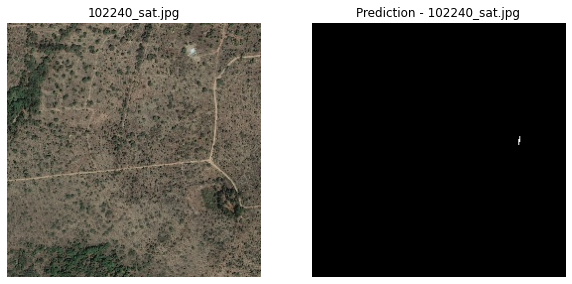

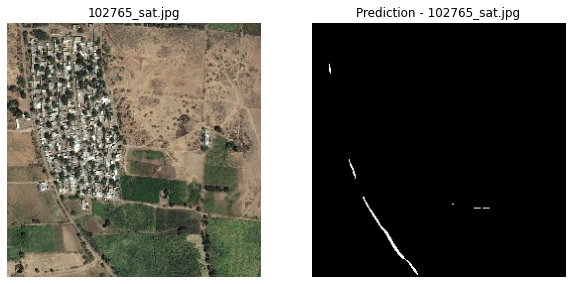

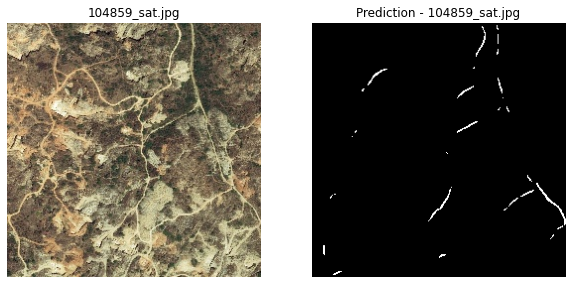

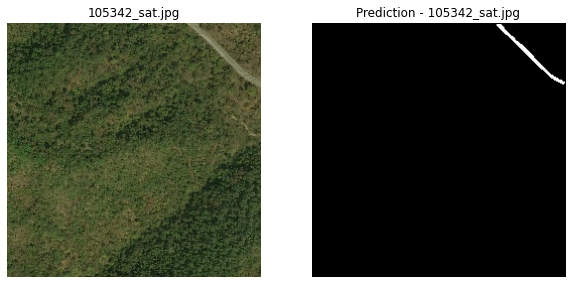

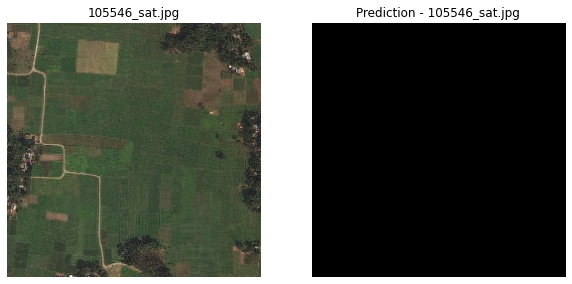

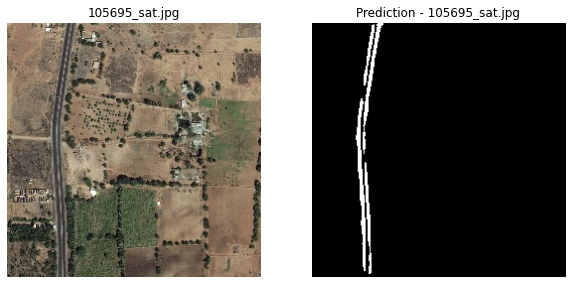

In [ ]:
ma.extract_road_path(x=test_data, model=model_a)

### 6.4. Inception

#### 6.4.1. Object creation

In [ ]:
ma = ModelDesignAugmetation(
    train_data=train_data,
    model_name='inceptionv3'
)

#### 6.4.2. Model training

In [ ]:
model_a = ma.train_model()

Model is already trained and is present in directory.


<center><img src="https://user-images.githubusercontent.com/63333753/153561217-e5eb8f90-d0d0-4679-84cd-57384ce78dd3.png"></center>

#### 6.4.3. Valid prediction

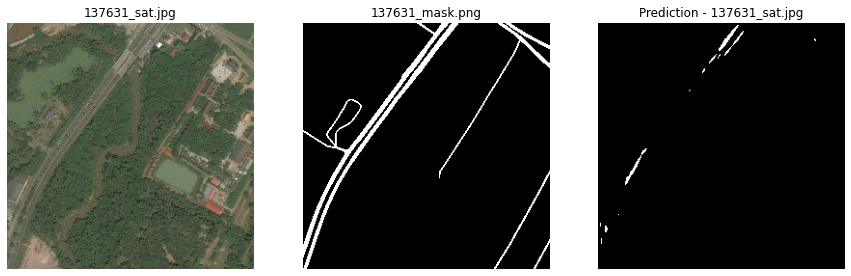

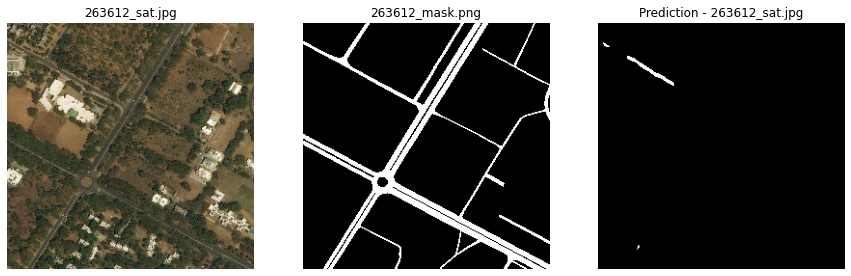

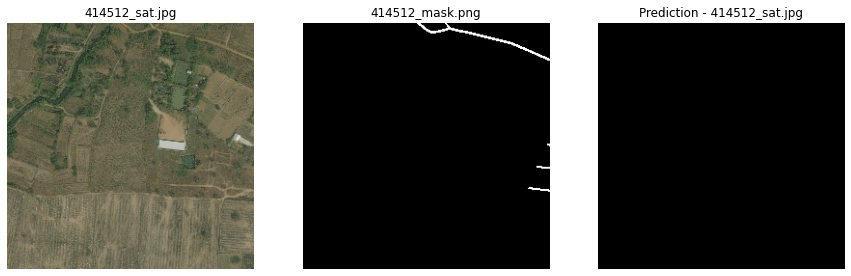

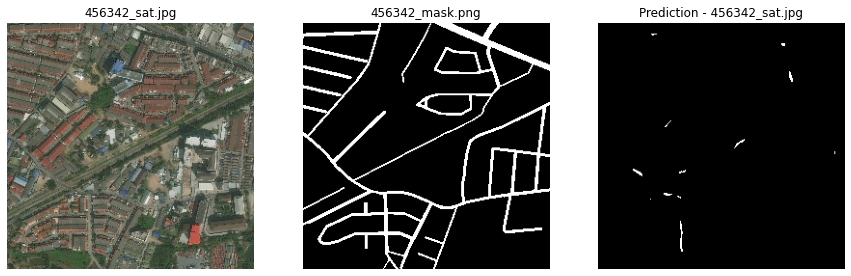

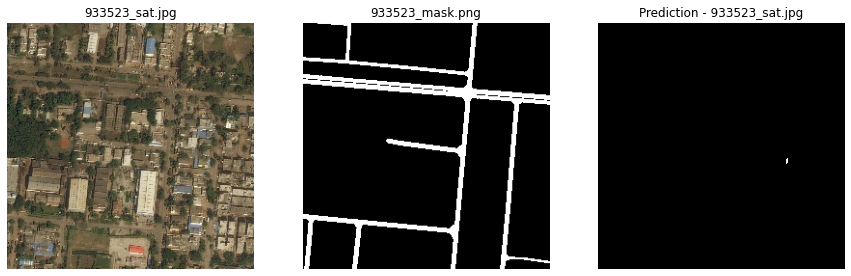

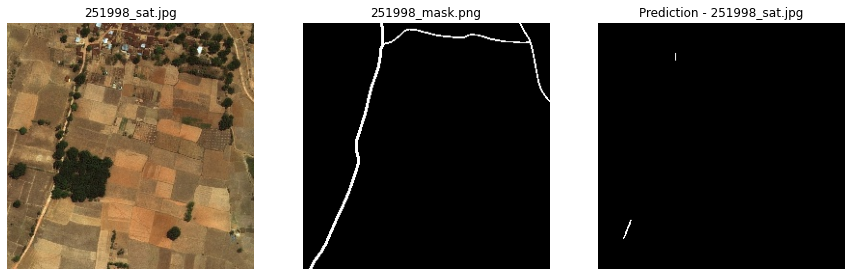

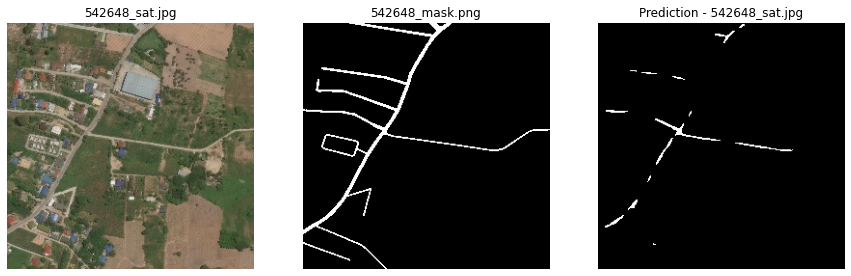

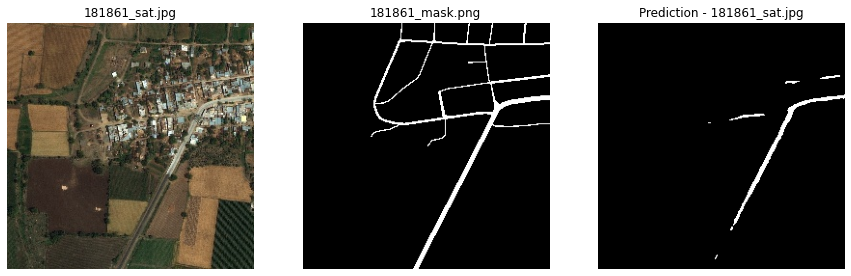

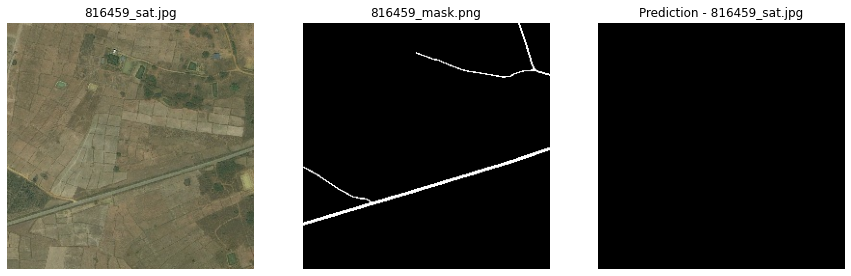

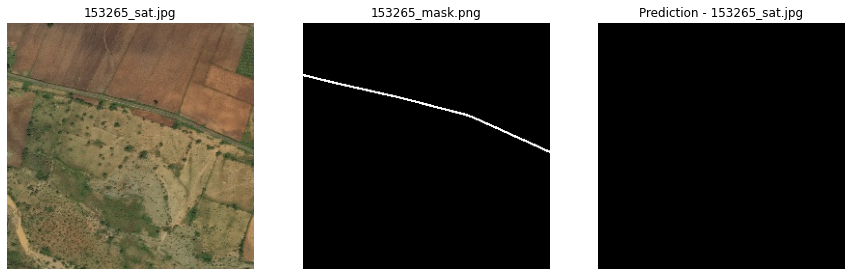

In [ ]:
ma.plot_custom_valid_performance(model=model_a)

#### 6.4.4. Test prediction

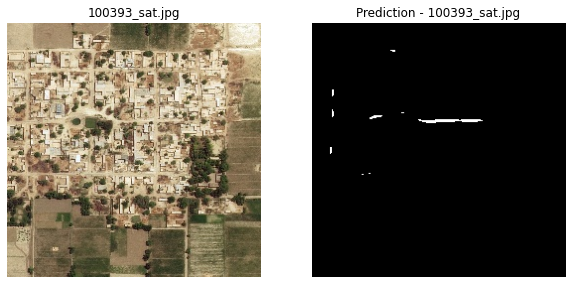

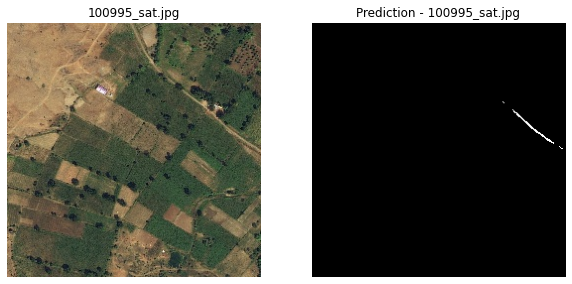

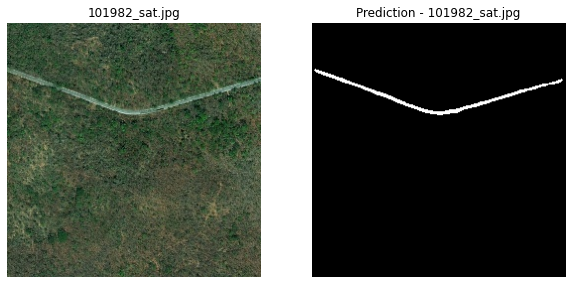

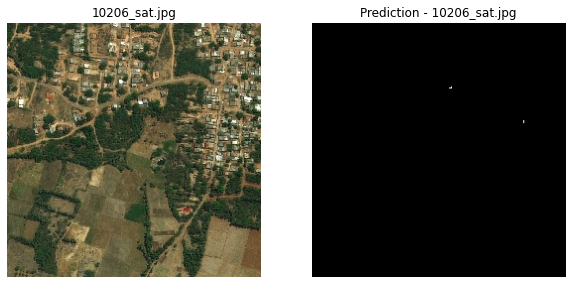

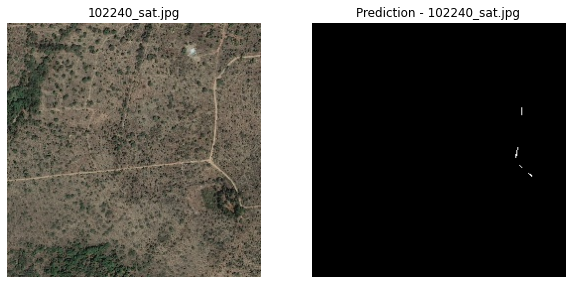

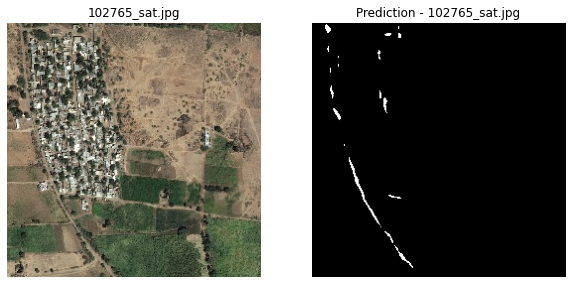

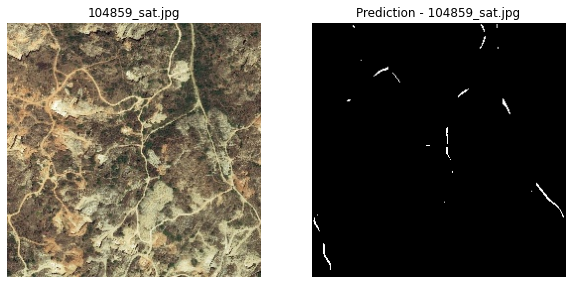

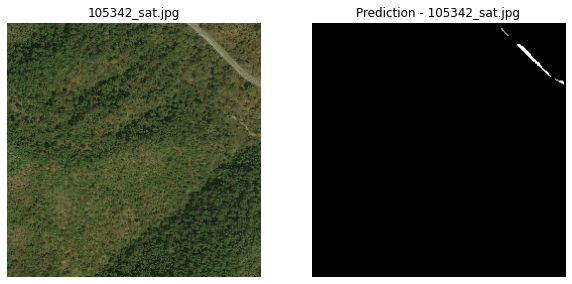

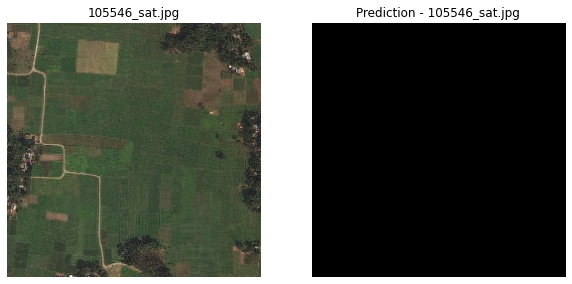

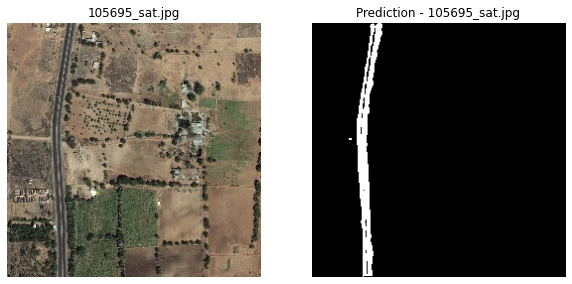

In [ ]:
ma.extract_road_path(x=test_data, model=model_a)

### 6.5. ResNet50

#### 6.5.1. Object creation

In [ ]:
ma = ModelDesignAugmetation(
    train_data=train_data,
    model_name='resnet50'
)

#### 6.5.2. Model training

In [ ]:
model_a = ma.train_model()

Model is already trained and is present in directory.


<center><img src="https://user-images.githubusercontent.com/63333753/153566818-82378c00-fffb-4ea9-a4c7-bf38eda19aca.png"></center>

#### 6.5.3. Valid prediction

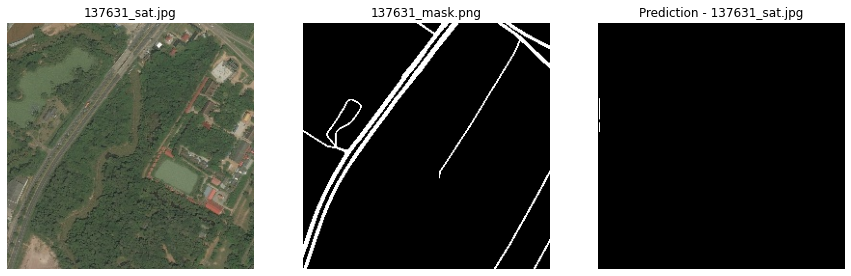

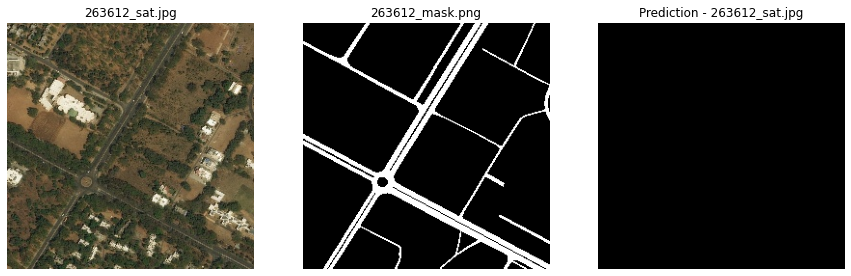

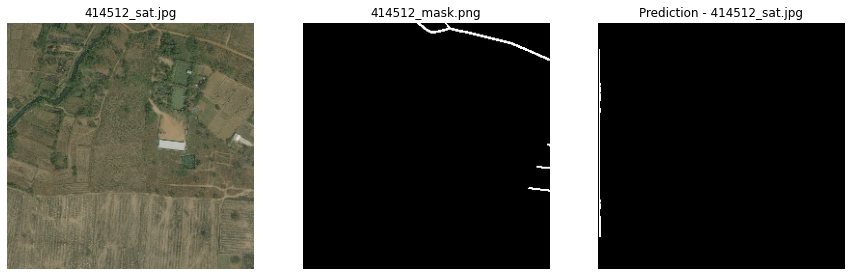

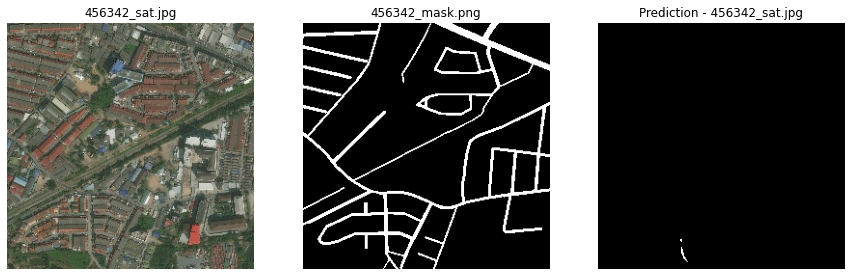

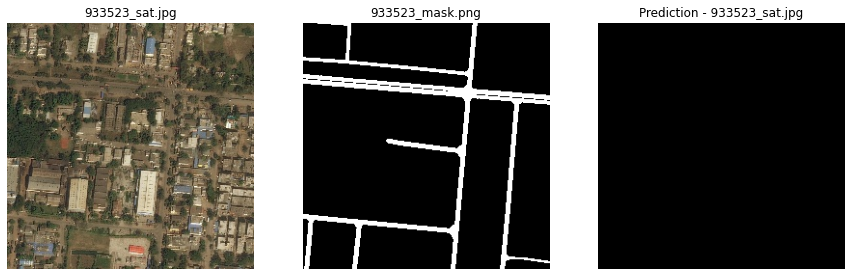

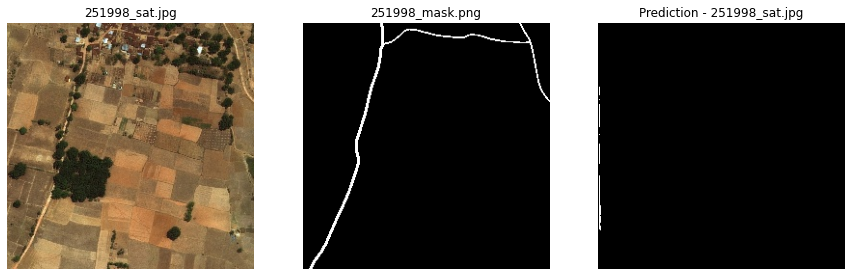

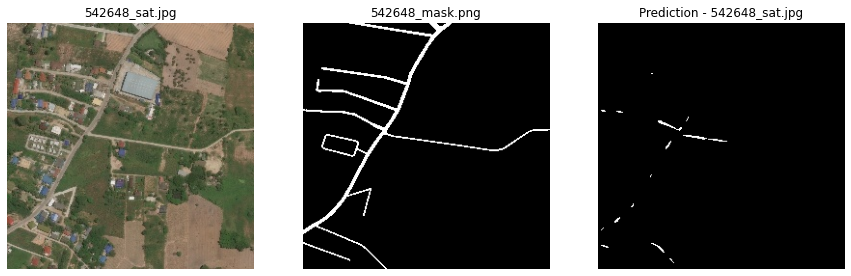

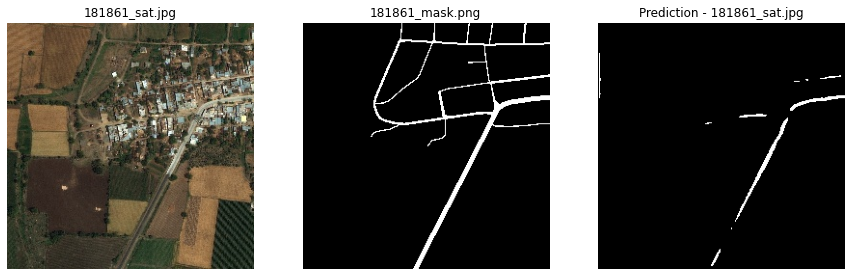

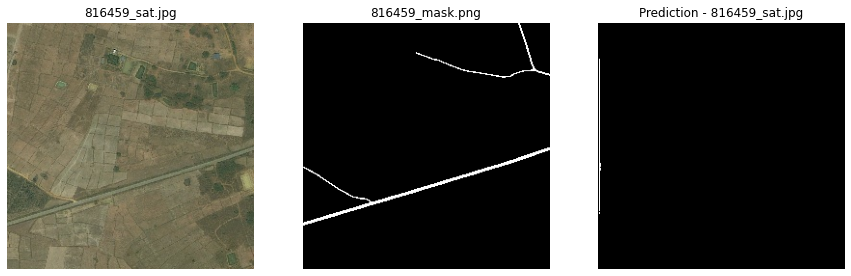

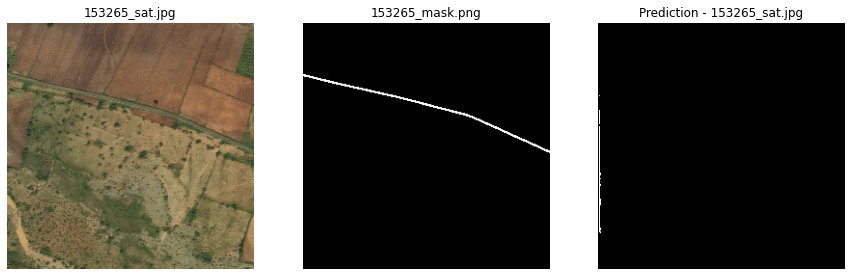

In [ ]:
ma.plot_custom_valid_performance(model=model_a)

#### 6.5.4. Test prediction

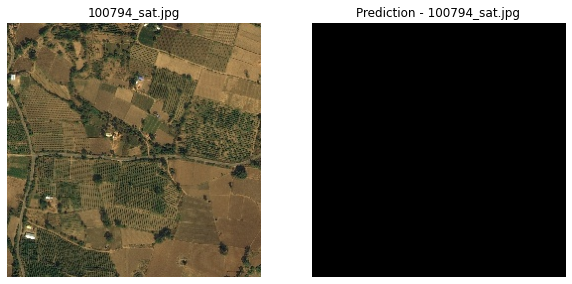

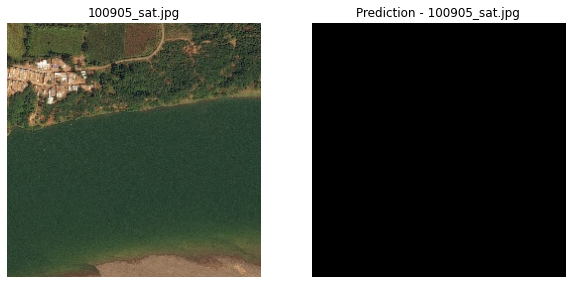

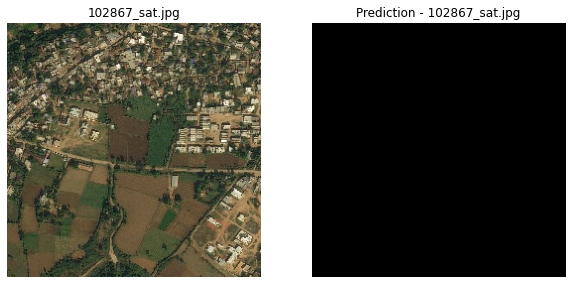

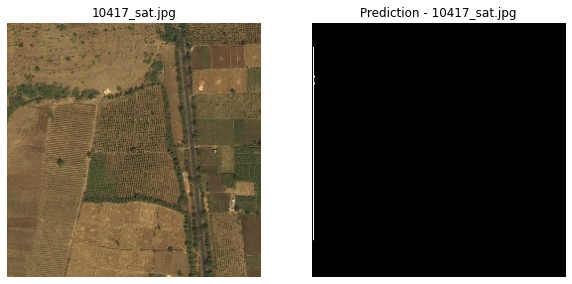

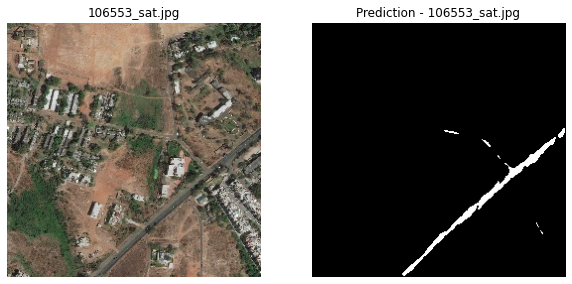

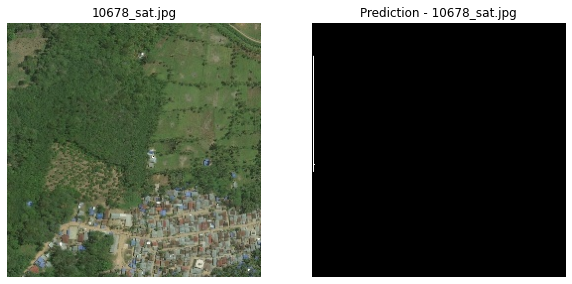

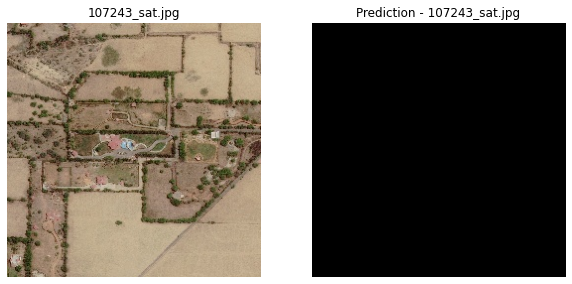

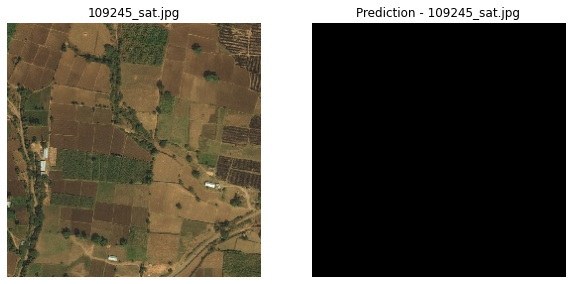

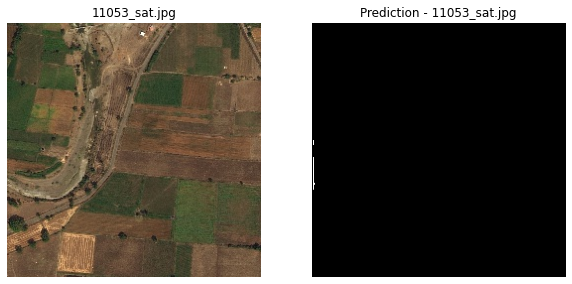

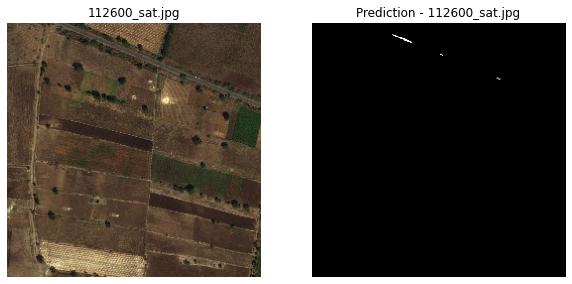

In [ ]:
ma.extract_road_path(x=valid_data, model=model_a)

### 6.6. EfficientNet

#### 6.6.1. Object creation

In [ ]:
# ma = ModelDesignAugmetation(
#     train_data=train_data,
#     model_name='efficientnetb0'
# )

#### 6.6.2. Model training

In [ ]:
# model_a = ma.train_model()

#### 6.6.3. Valid prediction

In [ ]:
# ma.plot_custom_valid_performance(model=model_a)

#### 6.6.4. Test prediction

In [ ]:
# ma.extract_road_path(x=test_data, model=model_a)

## 7. No Augmentation VS Augmention

* Comparing the results in order to select the best model.

<center><img src="https://user-images.githubusercontent.com/63333753/153599357-ad76dff1-8bae-4490-9adf-659806ec4c95.png"></center>

* The results of the augmented data are not so good compared with the original data (no augmentation). Clearly it can be noted by checking the performances of the various models.

* In fact the masks obtained for the augmented data are not as clear as the masks obtained for the original (no augmentation) data.

* Hence, it is not a valid decision to consider the models that have been trained on the augmented data.

* The only option left now is to select the best model out of other models that have been trained on the original (no augmentation) data.

* The best model(s) from all the above models are `ResNet34`, `VGG16`, and `Inception`.